<a href="https://colab.research.google.com/github/Rbenismail/Tick-Tick-Bloom-NASA-TUNSA/blob/main/tick_tick_bloom_image_processing_method.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:


from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import os
import requests
from tqdm.auto import tqdm

In [ ]:
os.chdir('/content/drive/MyDrive/DrivenData')

In [ ]:
# Function to download data
def data_downloader(url, token, file_name):
    # Get the competition data
    competition_data = requests.post(url = data_url, data= token, stream=True)

    # Progress bar monitor download
    pbar = tqdm(desc=file_name, total=int(competition_data.headers.get('content-length', 0)), unit='B', unit_scale=True, unit_divisor=512)
    # Create and Write the data to colab drive in chunks
    handle = open(file_name, "wb")
    for chunk in competition_data.iter_content(chunk_size=512): # Download the data in chunks
        if chunk: # filter out keep-alive new chunks
                handle.write(chunk)
        pbar.update(len(chunk))
    handle.close()
    pbar.close()

## intalling dependencies

In [ ]:
!pip install pystac
!pip install pystac_client
!pip install planetary_computer
!pip install nb_black
!pip install odc-stac
!pip install geopandas
!pip install rioxarray
!pip install loguru
!pip install opencv-python
!pip install geopy
!pip install path
!pip install tqdm

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 146.0/146.0 KB 5.2 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.8/62.8 KB 5.4 MB/s eta 0:00:00
  Attempting uninstall: requests
    Found existing installation: requests 2.25.1
    Uninstalling requests-2.25.1:
      Successfully uninstalled requests-2.25.1
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 21.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 96.6/96.6 KB 11.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 65.7 MB/s eta 0:00:00


In [ ]:
!pip install rasterio

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


#importing dependencies

In [ ]:
%load_ext lab_black
%load_ext autoreload
%autoreload 2

In [ ]:
import cv2
from datetime import timedelta
import matplotlib.pyplot as plt
import numpy as np
import odc.stac
import pandas as pd
from pathlib import Path
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler
from tqdm import tqdm

%matplotlib inline

# **metadata.csv**

In [ ]:
metadata = pd.read_csv("metadata.csv")
metadata.head()

,uid,latitude,longitude,date,split
0,aabm,39.080319,-86.430867,2018-05-14,train
1,aabn,36.559700,-121.510000,2016-08-31,test
2,aacd,35.875083,-78.878434,2020-11-19,train
3,aaee,35.487000,-79.062133,2016-08-24,train
4,aaff,38.049471,-99.827001,2019-07-23,train


In [ ]:
metadata.split.value_counts(dropna=False)

train    17060
test      6510
Name: split, dtype: int64

In [ ]:
metadata.loc[0]

uid                aabm
latitude      39.080319
longitude    -86.430867
date         2018-05-14
split             train
Name: 0, dtype: object

## Location

Let's take a look at the distribution of samples by location.

In [ ]:
import geopandas as gpd
from shapely.geometry import Point

# load the default geopandas base map file to plot points on
world = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))

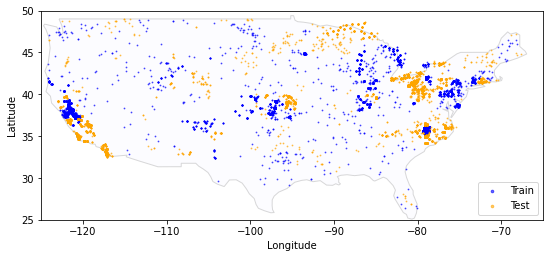

In [ ]:
fig, ax = plt.subplots(figsize=(9, 4))

# map the training data
base = world[world.name == "United States of America"].plot(
    edgecolor="gray", color="ghostwhite", figsize=(9, 4), alpha=0.3, ax=ax
)
train_meta = metadata[metadata["split"] == "train"]
geometry = [Point(xy) for xy in zip(train_meta["longitude"], train_meta["latitude"])]
gdf = gpd.GeoDataFrame(train_meta, geometry=geometry)
gdf.plot(ax=base, marker=".", markersize=3, color="blue", label="Train", alpha=0.6)

# map the test data
test_meta = metadata[metadata["split"] == "test"]
geometry = [Point(xy) for xy in zip(test_meta["longitude"], test_meta["latitude"])]
gdf = gpd.GeoDataFrame(test_meta, geometry=geometry)
gdf.plot(ax=base, marker=".", markersize=3, color="orange", label="Test", alpha=0.6)

plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.xlim([-125, -65])
plt.ylim([25, 50])
plt.legend(loc=4, markerscale=3)

We can see that the sampling points are distributed all throughout the continental United States.

## Date

What date range are the samples from?

In [ ]:
# convert date to pd.datetime
metadata.date = pd.to_datetime(metadata.date)

# what is the date range?
metadata.groupby("split").agg(min_date=("date", min), max_date=("date", max))

,min_date,max_date
split,,
test,2013-01-08,2021-12-29
train,2013-01-04,2021-12-14


Text(0.5, 1.0, 'Distribution of years in the data')

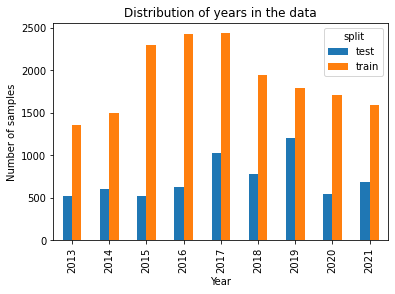

In [ ]:
# what years are in the data?
pd.crosstab(metadata.date.dt.year, metadata.split).plot(kind="bar")
plt.ylabel("Number of samples")
plt.xlabel("Year")
plt.title("Distribution of years in the data")

In [ ]:
# what seasons are the data points from?
metadata["season"] = (
    metadata.date.dt.month.replace([12, 1, 2], "winter")
    .replace([3, 4, 5], "spring")
    .replace([6, 7, 8], "summer")
    .replace([9, 10, 11], "fall")
)
metadata.season.value_counts()

summer    10813
spring     5045
fall       4758
winter     2954
Name: season, dtype: int64

Most of the data is from summer. Harmful algal blooms are more likely to be dangerous during the summer because more individuals are taking advantage of water bodies like lakes for recreation.

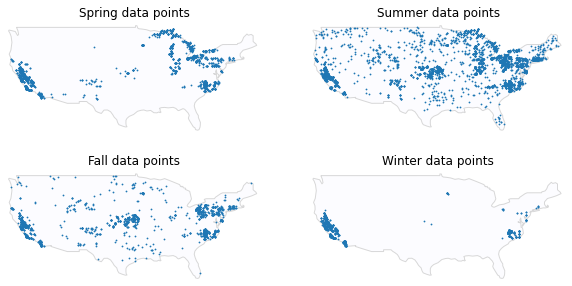

In [ ]:
# where is data from for each season?
fig, axes = plt.subplots(2, 2, figsize=(10, 5))

for season, ax in zip(metadata.season.unique(), axes.flatten()):
    base = world[world.name == "United States of America"].plot(
        edgecolor="gray", color="ghostwhite", alpha=0.3, ax=ax
    )

    sub = metadata[metadata.season == season]
    geometry = [Point(xy) for xy in zip(sub["longitude"], sub["latitude"])]
    gdf = gpd.GeoDataFrame(sub, geometry=geometry)
    gdf.plot(ax=base, marker=".", markersize=2.5)
    ax.set_xlim([-125, -66])
    ax.set_ylim([25, 50])
    ax.set_title(f"{season.capitalize()} data points")
    ax.axis("off")

## **train_labels.csv**

Let's look at the labels for the training data.


In [ ]:
train_labels = pd.read_csv("train_labels.csv")
train_labels.head(15)

,uid,region,severity,density
0,aabm,midwest,1,585.0
1,aacd,south,1,290.0
2,aaee,south,1,1614.0
3,aaff,midwest,3,111825.0
4,aafl,midwest,4,2017313.0
5,aafp,south,1,1594.0
6,aagm,south,1,3873.0
7,aahy,south,1,6100.0
8,aaia,south,1,16943.0
9,aaie,south,2,22822.0


In [ ]:
train_labels.shape

(17060, 4)

## **train_labels severity**


In [ ]:
train_labels_and_metadata = train_labels.merge(
    metadata, how="left", left_on="uid", right_on="uid", validate="1:1"
)

Text(0.5, 1.0, 'Train labels severity level counts')

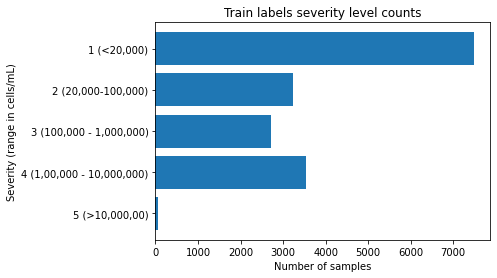

In [ ]:
severity_counts = (
    train_labels.replace(
        {
            "severity": {
                1: "1 (<20,000)",
                2: "2 (20,000-100,000)",
                3: "3 (100,000 - 1,000,000)",
                4: "4 (1,00,000 - 10,000,000)",
                5: "5 (>10,000,00)",
            }
        }
    )
    .severity.value_counts()
    .sort_index(ascending=False)
)
plt.barh(severity_counts.index, severity_counts.values)
plt.xlabel("Number of samples")
plt.ylabel("Severity (range in cells/mL)")
plt.title("Train labels severity level counts")

In [ ]:
train_labels.density.describe()

count    1.706000e+04
mean     1.074537e+06
std      6.836693e+06
min      0.000000e+00
25%      4.066000e+03
50%      3.270975e+04
75%      4.849192e+05
max      8.046675e+08
Name: density, dtype: float64

There are also some rows where the density of cyanobacteria is 0.

In [ ]:
(train_labels.density == 0).sum()

91

## submission_format.csv

To create your own submission, download the submission format and replace the severity column with your own prediction values. To be scored correctly, the order of your predictions must match the order of uids in the submission format.

In [ ]:
submission_format = pd.read_csv("submission_format.csv", index_col=0)
submission_format.head()

,region,severity
uid,,
aabn,west,1
aair,west,1
aajw,northeast,1
aalr,midwest,1
aalw,west,1


In [ ]:
submission_format.shape

(6510, 2)

# **Process feature data**

**participants will access all feature data through external, publicly available APIs**

Relevant imagery can be identified using the location and date of each sample, listed in metadata.csv

**The general steps we'll use to pull satellite data are:**

1. Establish a connection to the Planetary Computer's STAC API using the planetary_computer and pystac_client Python packages.

2. Query the STAC API for scenes that capture our in situ labels. For each sample, we'll search for imagery that includes the sample's location (latitude and longitude) around the date the sample was taken. In this benchmark, we'll use only Sentinel-2 L2A and Landsat Level-2 data.

3. Select one image for each sample. We'll use Sentinel-2 data wherever it is available, because it is higher resolution. We'll have to use Landsat for data before roughly 2016, because Sentinel-2 was not available yet.

4. **Convert the image to a 1-dimensional list of features that can be input into our tree model**

In [ ]:
# Establish a connection to the STAC API
import planetary_computer as pc
from pystac_client import Client

catalog = Client.open(
    "https://planetarycomputer.microsoft.com/api/stac/v1", modifier=pc.sign_inplace
)

## **WALK THROUGH PULLING FEATURE DATA FOR ONE SAMPLE**

Query the STAC API

## Chose the img with high bloom severity

abbf

## pilote exemple

In [ ]:
metadata[metadata.uid == random.choice(list(bloom_tr.uid))]

In [ ]:
import random
bloom_tr = train_labels.loc[train_labels["severity"].isin([3,4]),:]
#example_row = metadata[metadata.uid == "garm"].iloc[0] #yvab #aaqq
example_row = metadata[metadata.uid == random.choice(list(bloom_tr.uid))].iloc[0]
example_row

uid                pfrf
latitude        37.1366
longitude      -120.762
date         2021-04-13
split             train
Name: 13838, dtype: object

In [ ]:
#example_row.latitude , example_row.longitude = 36.63620014369792, -120.61886561709358

In [ ]:
example_row.latitude , example_row.longitude = 37.055797, -121.126144

In [ ]:
example_row.latitude

37.055797

We can search (41.98006, -110.65734) in Google maps to see example where this sample is from. Turns out it's from **Lake Viva Naughton in Wyoming!**
[link](https://www.google.com/maps/place/41%C2%B058'48.2%22N+110%C2%B039'26.4%22W/@41.98006,-110.65734,17z/data=!3m1!4b1!4m5!3m4!1s0x0:0x55302267be6c32c8!8m2!3d41.98006!4d-110.65734)

In [ ]:
import geopy.distance as distance

In [ ]:
# get our bounding box to search latitude and longitude coordinates
def get_bounding_box(latitude, longitude, meter_buffer):
    """
    Given a latitude, longitude, and buffer in meters, returns a bounding
    box around the point with the buffer on the left, right, top, and bottom.

    Returns a list of [minx, miny, maxx, maxy]
    """
    distance_search = distance.distance(meters=meter_buffer)

    # calculate the lat/long bounds based on ground distance
    # bearings are cardinal directions to move (south, west, north, and east)
    min_lat = distance_search.destination((latitude, longitude), bearing=180)[0]
    min_long = distance_search.destination((latitude, longitude), bearing=270)[1]
    max_lat = distance_search.destination((latitude, longitude), bearing=0)[0]
    max_long = distance_search.destination((latitude, longitude), bearing=90)[1]

    return [min_long, min_lat, max_long, max_lat]
bbox = get_bounding_box(example_row.latitude, example_row.longitude, meter_buffer=50000)
bbox

[-121.32472575208074,
 36.686052063704345,
 -120.19927424791926,
 37.587113611339895]

In [ ]:
# get our date range to search, and format correctly for query
def get_date_range(date, time_buffer_days=15):
    """Get a date range to search for in the planetary computer based
    on a sample's date. The time range will include the sample date
    and time_buffer_days days prior

    Returns a string"""
    #datetime_format = "%Y-%m-%dT"
    datetime_format = "%Y-%m-%dT%H:%M:%SZ"
    range_start = pd.to_datetime(date) - timedelta(days=time_buffer_days)
    date_range = f"{range_start.strftime(datetime_format)}/{pd.to_datetime(date).strftime(datetime_format)}"

    return date_range


date_range = get_date_range(example_row.date)
data_list = date_range.split('/')
data_list

['2021-03-29T00:00:00Z', '2021-04-13T00:00:00Z']

debug: change date time format to "%Y-%m-%dT%H:%M:%SZ"

In [ ]:
# search the planetary computer sentinel-l2a and landsat level-2 collections
search = catalog.search(
    collections=["sentinel-2-l2a"], bbox=bbox, datetime=data_list
    )

# see how many items were returned
items = [item for item in search.get_all_items()]
len(items)

36

### Select one image
The planetary computer returned 46 different items! Let's look at some of the details of the items that were found to match our label.

Remember that our example measurement was taken on 2021-09-27 at coordinates (41.98006, -110.65734). Because we used a bounding box around the sample to search, the Planetary Computer returned all items that contain any part of that bounding box. This means we still have to double check whether each item actually contains our sample point.

In [ ]:
# get details of all of the items returned
item_details = pd.DataFrame(
    [
        {
            "datetime": item.datetime.strftime("%Y-%m-%d"),
            #"datetime": item.datetime.strftime("%Y-%m-%dT%H:%M:%SZ")
            "platform": item.properties["platform"],
            "min_long": item.bbox[0],
            "max_long": item.bbox[2],
            "min_lat": item.bbox[1],
            "max_lat": item.bbox[3],
            "bbox": item.bbox,
            "cloud": mean([item.properties['s2:cloud_shadow_percentage'] , item.properties['s2:high_proba_clouds_percentage']*100]),
            "item_obj": item,
        }
        for item in items
    ]
)

# check which rows actually contain the sample location
item_details["contains_sample_point"] = (
    (item_details.min_lat < example_row.latitude)
    & (item_details.max_lat > example_row.latitude)
    & (item_details.min_long < example_row.longitude)
    & (item_details.max_long > example_row.longitude)
)

print(
    f"Filtering from {len(item_details)} returned to {item_details.contains_sample_point.sum()} items that contain the sample location"
)



In [ ]:
item_details.columns

Index(['datetime', 'platform', 'min_long', 'max_long', 'min_lat', 'max_lat',
       'bbox', 'item_obj', 'contains_sample_point'],
      dtype='object')

In [ ]:
item_details = item_details[item_details["contains_sample_point"]]
item_details[["datetime", "platform", "contains_sample_point", "bbox"]].sort_values(
    by="datetime"
)

,datetime,platform,contains_sample_point,bbox
34,2021-03-30,Sentinel-2A,True,"[-121.876816, 36.93451075320804, -120.61305, 3..."
28,2021-04-01,Sentinel-2B,True,"[-121.26152, 36.93451075320804, -120.61305, 37..."
22,2021-04-04,Sentinel-2B,True,"[-121.876816, 36.93451075320804, -120.61305, 3..."
16,2021-04-06,Sentinel-2A,True,"[-121.25574, 36.93451075320804, -120.61305, 37..."
10,2021-04-09,Sentinel-2A,True,"[-121.876816, 36.93451075320804, -120.61305, 3..."
4,2021-04-11,Sentinel-2B,True,"[-121.25658, 36.93451075320804, -120.61305, 37..."


In [ ]:
# 1 - filter to sentinel
item_details[item_details.platform.str.contains("Sentinel")]

,datetime,platform,min_long,max_long,min_lat,max_lat,bbox,item_obj,contains_sample_point
4,2021-04-11,Sentinel-2B,-121.256580,-120.61305,36.934511,37.928810,"[-121.25658, 36.93451075320804, -120.61305, 37...",<Item id=S2B_MSIL2A_20210411T183919_R070_T10SF...,True
10,2021-04-09,Sentinel-2A,-121.876816,-120.61305,36.934511,37.942085,"[-121.876816, 36.93451075320804, -120.61305, 3...",<Item id=S2A_MSIL2A_20210409T184911_R113_T10SF...,True
16,2021-04-06,Sentinel-2A,-121.255740,-120.61305,36.934511,37.928787,"[-121.25574, 36.93451075320804, -120.61305, 37...",<Item id=S2A_MSIL2A_20210406T183911_R070_T10SF...,True
22,2021-04-04,Sentinel-2B,-121.876816,-120.61305,36.934511,37.942085,"[-121.876816, 36.93451075320804, -120.61305, 3...",<Item id=S2B_MSIL2A_20210404T184919_R113_T10SF...,True
28,2021-04-01,Sentinel-2B,-121.261520,-120.61305,36.934511,37.928874,"[-121.26152, 36.93451075320804, -120.61305, 37...",<Item id=S2B_MSIL2A_20210401T183919_R070_T10SF...,True
34,2021-03-30,Sentinel-2A,-121.876816,-120.61305,36.934511,37.942085,"[-121.876816, 36.93451075320804, -120.61305, 3...",<Item id=S2A_MSIL2A_20210330T184941_R113_T10SF...,True


In [ ]:
#item_details.item_obj[0].properties

In [ ]:
# 2 - take closest by date
best_item = (
    item_details[item_details.platform.str.contains("Sentinel")]
    .sort_values(by="datetime", ascending=False)
    .iloc[1]
)
item = best_item.item_obj
best_item

datetime                                                        2021-04-09
platform                                                       Sentinel-2A
min_long                                                       -121.876816
max_long                                                        -120.61305
min_lat                                                          36.934511
max_lat                                                          37.942085
bbox                     [-121.876816, 36.93451075320804, -120.61305, 3...
item_obj                 <Item id=S2A_MSIL2A_20210409T184911_R113_T10SF...
contains_sample_point                                                 True
Name: 10, dtype: object

This gives us a Sentinel-2A item that was captured on 9/24/2021 -- three days before our sample was collected on 9/27/2021.

In [ ]:
item.properties

{'datetime': '2021-04-09T18:49:11.024000Z',
 'platform': 'Sentinel-2A',
 'proj:epsg': 32610,
 'instruments': ['msi'],
 's2:mgrs_tile': '10SFG',
 'constellation': 'Sentinel 2',
 's2:granule_id': 'S2A_OPER_MSI_L2A_TL_ESRI_20210411T045455_A030283_T10SFG_N02.12',
 'eo:cloud_cover': 5.883933,
 's2:datatake_id': 'GS2A_20210409T184911_030283_N02.12',
 's2:product_uri': 'S2A_MSIL2A_20210409T184911_N0212_R113_T10SFG_20210411T045454.SAFE',
 's2:datastrip_id': 'S2A_OPER_MSI_L2A_DS_ESRI_20210411T045455_S20210409T185339_N02.12',
 's2:product_type': 'S2MSI2A',
 'sat:orbit_state': 'descending',
 's2:datatake_type': 'INS-NOBS',
 's2:generation_time': '2021-04-11T04:54:54.462Z',
 'sat:relative_orbit': 113,
 's2:water_percentage': 1.025173,
 's2:mean_solar_zenith': 32.7734462994375,
 's2:mean_solar_azimuth': 150.524484973641,
 's2:processing_baseline': '02.12',
 's2:snow_ice_percentage': 3.3e-05,
 's2:vegetation_percentage': 46.752214,
 's2:thin_cirrus_percentage': 5.70822,
 's2:cloud_shadow_percentage'

In [ ]:
item.properties['proj:epsg']

32610

In [ ]:
item.properties['s2:cloud_shadow_percentage']
#item.properties['s2:snow_ice_percentage']

0.042528

In [ ]:
item.properties['s2:high_proba_clouds_percentage']

0.062047

In [ ]:
item.properties['s2:water_percentage']
item.properties['s2:cloud_shadow_percentage']
item.properties['s2:high_proba_clouds_percentage']
item.properties['s2:snow_ice_percentage']


16.401768

In [ ]:
item_properties = pd.DataFrame(
    [
        {
            "water_percentage": item.properties['s2:water_percentage'],
            "cloud_shadow_percentage": item.properties['s2:cloud_shadow_percentage'],
            "high_proba_clouds_percentage": item.properties['s2:high_proba_clouds_percentage'],
            "snow_ice_percentage": item.properties['s2:snow_ice_percentage'],
        }
    ]
)

In [ ]:
item_properties.head()

,water_percentage,cloud_shadow_percentage,high_proba_clouds_percentage,snow_ice_percentage
0,0.861518,0.078006,0.621708,0.0


In [ ]:
item

This item comes with a number of "assets". Let's see what these are.

In [ ]:
# What assets are available?
for asset_key, asset in item.assets.items():
    print(f"{asset_key:<25} - {asset.title}")

AOT                       - Aerosol optical thickness (AOT)
B01                       - Band 1 - Coastal aerosol - 60m
B02                       - Band 2 - Blue - 10m
B03                       - Band 3 - Green - 10m
B04                       - Band 4 - Red - 10m
B05                       - Band 5 - Vegetation red edge 1 - 20m
B06                       - Band 6 - Vegetation red edge 2 - 20m
B07                       - Band 7 - Vegetation red edge 3 - 20m
B08                       - Band 8 - NIR - 10m
B09                       - Band 9 - Water vapor - 60m
B11                       - Band 11 - SWIR (1.6) - 20m
B12                       - Band 12 - SWIR (2.2) - 20m
B8A                       - Band 8A - Vegetation red edge 4 - 20m
SCL                       - Scene classfication map (SCL)
WVP                       - Water vapour (WVP)
visual                    - True color image
preview                   - Thumbnail
safe-manifest             - SAFE manifest
granule-metadata          - Granul

### **Visualizing Sentinel-2 imagery**
Let's see what the imagery actually looks like.

##

In [ ]:
#!mkdir images

In [ ]:
import rioxarray
from IPython.display import Image
from PIL import Image as PILImage

In [ ]:
# see the whole image
img = Image(url=item.assets["rendered_preview"].href, width=500)

Image(url=item.assets["rendered_preview"].href, width=500)

### view assets

In [ ]:
item.assets["rendered_preview"].href

'https://planetarycomputer.microsoft.com/api/data/v1/item/preview.png?collection=sentinel-2-l2a&item=S2A_MSIL2A_20170301T190341_R113_T10SFG_20210208T184014&assets=visual&asset_bidx=visual%7C1%2C2%2C3&nodata=0&format=png'

In [ ]:
type(item.properties['proj:epsg'])

int

In [ ]:
pc.sign(item.assets["visual"].href)

'https://sentinel2l2a01.blob.core.windows.net/sentinel2-l2/10/S/GF/2017/03/01/S2A_MSIL2A_20170301T190341_N0212_R113_T10SGF_20210208T184016.SAFE/GRANULE/L2A_T10SGF_A008833_20170301T190342/IMG_DATA/R10m/T10SGF_20170301T190341_TCI_10m.tif?st=2023-02-07T18%3A07%3A49Z&se=2023-02-08T18%3A52%3A49Z&sp=rl&sv=2021-06-08&sr=c&skoid=c85c15d6-d1ae-42d4-af60-e2ca0f81359b&sktid=72f988bf-86f1-41af-91ab-2d7cd011db47&skt=2023-02-08T15%3A49%3A29Z&ske=2023-02-15T15%3A49%3A29Z&sks=b&skv=2021-06-08&sig=MJjp6pR9gRmgX2WvyGlIIvoOxyjc0S7nNe1D4xJAotc%3D'

In [ ]:
item.assets["visual"].href

'https://sentinel2l2a01.blob.core.windows.net/sentinel2-l2/10/S/GF/2017/03/01/S2A_MSIL2A_20170301T190341_N0212_R113_T10SGF_20210208T184016.SAFE/GRANULE/L2A_T10SGF_A008833_20170301T190342/IMG_DATA/R10m/T10SGF_20170301T190341_TCI_10m.tif?st=2023-02-07T18%3A07%3A49Z&se=2023-02-08T18%3A52%3A49Z&sp=rl&sv=2021-06-08&sr=c&skoid=c85c15d6-d1ae-42d4-af60-e2ca0f81359b&sktid=72f988bf-86f1-41af-91ab-2d7cd011db47&skt=2023-02-08T15%3A49%3A29Z&ske=2023-02-15T15%3A49%3A29Z&sks=b&skv=2021-06-08&sig=MJjp6pR9gRmgX2WvyGlIIvoOxyjc0S7nNe1D4xJAotc%3D'

In [ ]:
espg = item.properties['proj:epsg']
print(espg)

32612


### **Crop Sentinel**

That's a LOT of area, and all we care about is right around our sampling point. Let's get a closer to look to make sure we're in the right neighborhood

In [ ]:
def crop_sentinel_image(item, bounding_box):
    """
    Given a STAC item from Sentinel-2 and a bounding box tuple in the format
    (minx, miny, maxx, maxy), return a cropped portion of the item's visual
    imagery in the bounding box.

    Returns the image as a numpy array with dimensions (color band, height, width)
    """
    (minx, miny, maxx, maxy) = bounding_box
    espg = item.properties['proj:epsg']
    image = rioxarray.open_rasterio(pc.sign(item.assets["visual"].href)).rio.clip_box(
        minx=minx,
        miny=miny,
        maxx=maxx,
        maxy=maxy,
        crs="EPSG:4326"
        #crs="EPSG:" + str(espg),
    )

    return image.to_numpy()

In [ ]:
# get a smaller geographic bounding box
minx, miny, maxx, maxy = get_bounding_box(
    example_row.latitude, example_row.longitude, meter_buffer=35000
)

In [ ]:
# get the zoomed in image array
bbox = (minx, miny, maxx, maxy)
bbox

(-121.37786756713453, 37.0050298361812, -120.58813243286548, 37.63575331507101)

In [ ]:
zoomed_img_array = crop_sentinel_image(item, bbox)
zoomed_img_array[0]

array([[ 49,  48,  45, ..., 215, 215, 212],
       [ 71,  43,  45, ..., 210, 202, 201],
       [138,  79,  46, ..., 181, 130, 124],
       ...,
       [205, 196, 190, ..., 255, 255, 255],
       [227, 222, 213, ..., 255, 253, 209],
       [232, 230, 233, ..., 207, 214, 180]], dtype=uint8)

In [ ]:
zoomed_img_array.shape

(3, 7148, 6668)

In [ ]:
cv2.imwrite('/content/drive/MyDrive/DrivenData/zoomed_img.jpg',zoomed_img_array)

False

In [ ]:
img.save('zoomed_img.jpg')

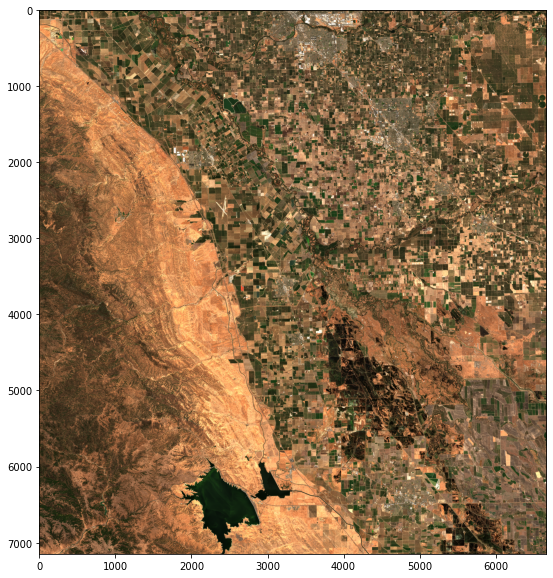

In [ ]:
# we have to transpose some of the dimensions to plot
# matplotlib expects channels in a certain order
plt.figure(figsize=(10,10))
plt.imshow(np.transpose(zoomed_img_array, axes=[1, 2, 0]))

In [ ]:
crop_image = zoomed_img_array[:,6000:, :2000]

In [ ]:
crop_image.shape

(3, 542, 543)

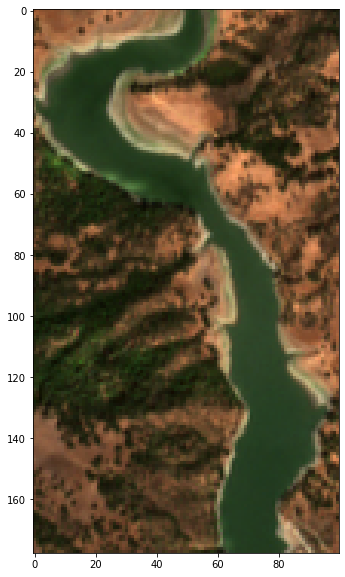

In [ ]:
plt.figure(figsize=(10,10))
plt.imshow(np.transpose(zoomed_img_array[:,6450:-520, 800:900], axes=[1, 2, 0]))

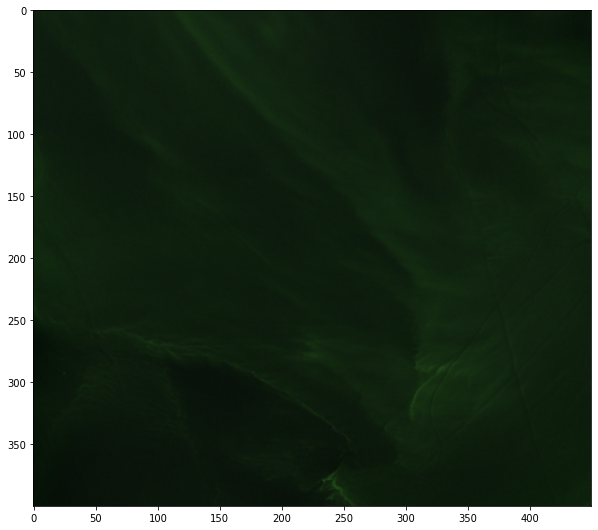

In [ ]:
plt.figure(figsize=(10,10))
plt.imshow(np.transpose(zoomed_img_array[:,6300:6700, 2200:2650], axes=[1, 2, 0]))

In [ ]:
import rasterio
from rasterio import windows
from rasterio import features
from rasterio import warp
import numpy as np
#from PIL import Image

In [ ]:
#espg = item.properties['proj:epsg']
asset_href = item.assets["visual"].href
with rasterio.open(asset_href) as ds:
    #aoi_bounds = features.bounds(area_of_interest)
    aoi_bounds = bbox
    warped_aoi_bounds = warp.transform_bounds("epsg:4326", ds.crs, *aoi_bounds)
    aoi_window = windows.from_bounds(transform=ds.transform, *warped_aoi_bounds)
    band_data = ds.read(window=aoi_window)

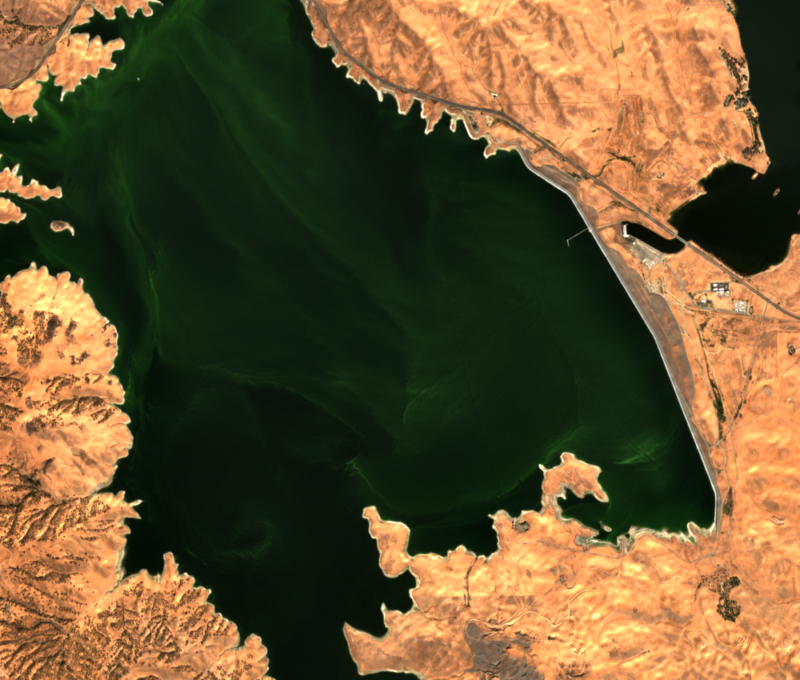

In [ ]:
img = PILImage.fromarray(np.transpose(zoomed_img_array[:,6100:6950, 2000:3000], axes=[1, 2, 0]))
w = img.size[0]
h = img.size[1]
aspect = w / h
target_w = 800
target_h = (int)(target_w / aspect)
img.resize((target_w, target_h),resample = PILImage.BILINEAR)

In [ ]:
zoomed_img_array[:,6450:-520, 800:900]

array([[[140, 154, 141, ...,  31,  24,  30],
        [163, 158, 151, ...,  46,  47,  35],
        [159, 129, 156, ...,  50,  54,  44],
        ...,
        [113,  80,  54, ...,  88, 132, 136],
        [112, 113, 104, ..., 118, 131, 126],
        [118, 131, 109, ..., 140, 125, 129]],

       [[ 81,  89,  83, ...,  25,  23,  30],
        [ 97,  95,  87, ...,  37,  46,  35],
        [103,  79,  96, ...,  42,  44,  38],
        ...,
        [ 75,  64,  51, ...,  65,  81,  85],
        [ 77,  79,  76, ...,  81,  78,  81],
        [ 78,  87,  79, ...,  94,  71,  84]],

       [[ 47,  51,  47, ...,  14,  10,  11],
        [ 57,  54,  51, ...,  19,  24,  19],
        [ 62,  48,  55, ...,  21,  26,  23],
        ...,
        [ 52,  39,  25, ...,  38,  55,  56],
        [ 55,  58,  45, ...,  49,  53,  52],
        [ 55,  64,  50, ...,  56,  44,  51]]], dtype=uint8)

In [ ]:
zoomed_img_array.shape

(3, 1123, 1122)

### LBP

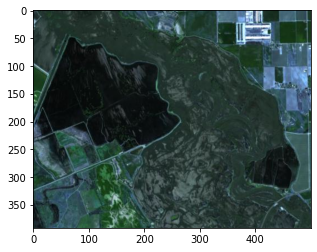

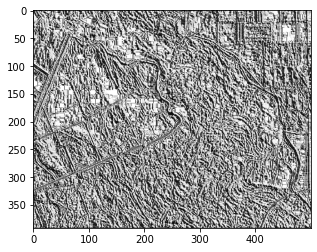

LBP Program is finished


In [ ]:
import cv2
import numpy as np
from matplotlib import pyplot as plt


def get_pixel(img, center, x, y):

	new_value = 0

	try:
		# If local neighbourhood pixel
		# value is greater than or equal
		# to center pixel values then
		# set it to 1
		if img[x][y] >= center:
			new_value = 1

	except:
		# Exception is required when
		# neighbourhood value of a center
		# pixel value is null i.e. values
		# present at boundaries.
		pass

	return new_value

# Function for calculating LBP
def lbp_calculated_pixel(img, x, y):

	center = img[x][y]

	val_ar = []

	# top_left
	val_ar.append(get_pixel(img, center, x-1, y-1))

	# top
	val_ar.append(get_pixel(img, center, x-1, y))

	# top_right
	val_ar.append(get_pixel(img, center, x-1, y + 1))

	# right
	val_ar.append(get_pixel(img, center, x, y + 1))

	# bottom_right
	val_ar.append(get_pixel(img, center, x + 1, y + 1))

	# bottom
	val_ar.append(get_pixel(img, center, x + 1, y))

	# bottom_left
	val_ar.append(get_pixel(img, center, x + 1, y-1))

	# left
	val_ar.append(get_pixel(img, center, x, y-1))

	# Now, we need to convert binary
	# values to decimal
	power_val = [1, 2, 4, 8, 16, 32, 64, 128]

	val = 0

	for i in range(len(val_ar)):
		val += val_ar[i] * power_val[i]

	return val

path = 'zoomed_img.jpg'
img_bgr = cv2.imread(path, 1)
#img_bgr = zoomed_img_array.copy()
height, width, _ = img_bgr.shape

# We need to convert RGB image
# into gray one because gray
# image has one channel only.
img_gray = cv2.cvtColor(img_bgr,
						cv2.COLOR_BGR2GRAY)

# Create a numpy array as
# the same height and width
# of RGB image
img_lbp = np.zeros((height, width),
				np.uint8)

for i in range(0, height):
	for j in range(0, width):
		img_lbp[i, j] = lbp_calculated_pixel(img_gray, i, j)

plt.imshow(img_bgr)
plt.show()

plt.imshow(img_lbp, cmap ="gray")
plt.show()

print("LBP Program is finished")


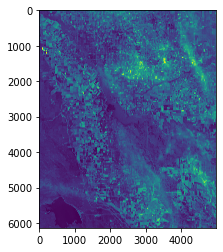

In [ ]:
plt.imshow(zoomed_img_array[2])

In [ ]:
h , w , c =img_bl.shape

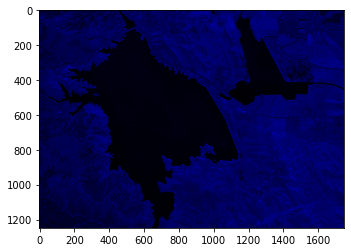

In [ ]:
img_bl = PILImage.fromarray(np.transpose(zoomed_img_array[:,5900:, 1750:3500], axes=[1,2,0]))
img_bl = np.asarray(img_bl)
img_bl_only = img_bl.copy()
for i in range(h):
  for j in range(w):
    img_bl_only[i,j,0] = 0
    img_bl_only[i,j,1] = 0
#img_bl.resize((target_w, target_h),resample = PILImage.BILINEAR)
plt.imshow(img_bl_only)

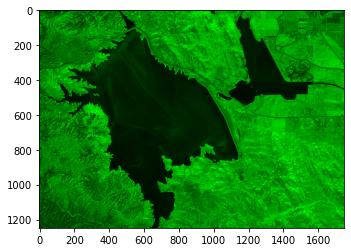

In [ ]:
img_bl = PILImage.fromarray(np.transpose(zoomed_img_array[:,5900:, 1750:3500], axes=[1,2,0]))
img_bl = np.asarray(img_bl)
img_bl_only = img_bl.copy()
for i in range(h):
  for j in range(w):
    img_bl_only[i,j,0] = 0
    img_bl_only[i,j,2] = 0
#img_bl.resize((target_w, target_h),resample = PILImage.BILINEAR)
plt.imshow(img_bl_only)

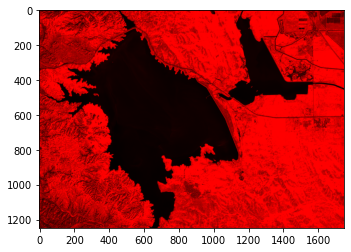

In [ ]:
img_bl = PILImage.fromarray(np.transpose(zoomed_img_array[:,5900:, 1750:3500], axes=[1,2,0]))
img_bl = np.asarray(img_bl)
img_bl_only = img_bl.copy()
for i in range(h):
  for j in range(w):
    img_bl_only[i,j,1] = 0
    img_bl_only[i,j,2] = 0
#img_bl.resize((target_w, target_h),resample = PILImage.BILINEAR)
plt.imshow(img_bl_only)

In [ ]:
img_bl_only

In [ ]:
img_bl_only[:,:,2]

array([[42, 42, 44, ..., 60, 54, 54],
       [41, 44, 46, ..., 55, 54, 55],
       [46, 49, 43, ..., 49, 50, 52],
       ...,
       [25, 27, 31, ..., 86, 81, 81],
       [25, 26, 30, ..., 75, 70, 65],
       [26, 27, 29, ..., 53, 52, 51]], dtype=uint8)

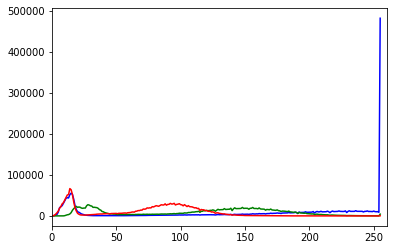

In [ ]:
import numpy as np
#import cv2 as cv
from matplotlib import pyplot as plt

color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv2.calcHist(zoomed_img_array[:,5900:, 1750:3500],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,260])
plt.show()

In [ ]:
histr

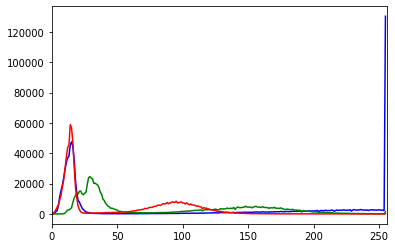

In [ ]:
import numpy as np
import cv2 as cv
from matplotlib import pyplot as plt

color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv.calcHist(zoomed_img_array[:,6100:6950, 2000:3000],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
plt.show()

###**0% land lake spot**

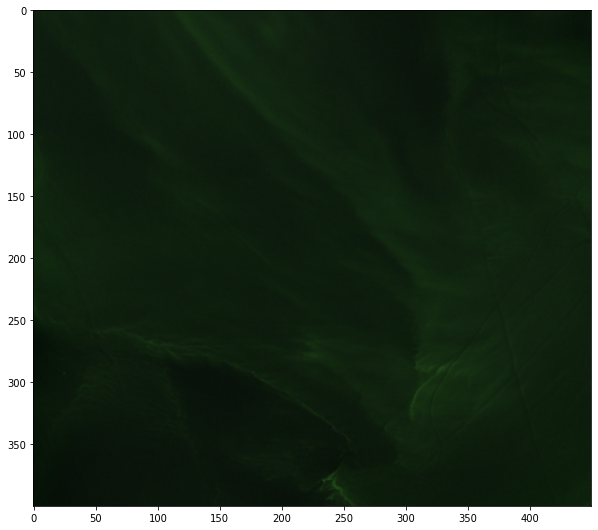

In [ ]:
plt.figure(figsize=(10,10))
plt.imshow(np.transpose(zoomed_img_array[:,6300:6700, 2200:2650], axes=[1, 2, 0]))

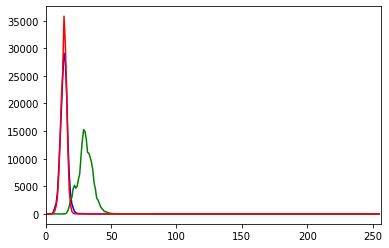

In [ ]:
import numpy as np
import cv2 as cv
from matplotlib import pyplot as plt

color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv.calcHist(zoomed_img_array[:,6300:6700, 2200:2650],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
plt.show()

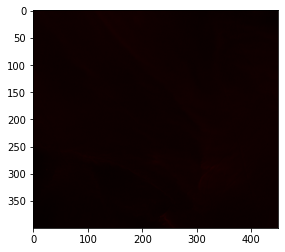

In [ ]:
img_rd = PILImage.fromarray(np.transpose(zoomed_img_array[:,6300:6700, 2200:2650], axes=[1,2,0]))
img_rd = np.asarray(img_rd)
img_rd_only = img_rd.copy()
h, w, c = img_rd.shape

for i in range(h):
  for j in range(w):
    img_rd_only[i,j,1] = 0
    img_rd_only[i,j,2] = 0
#img_bl.resize((target_w, target_h),resample = PILImage.BILINEAR)
plt.imshow(img_rd_only)

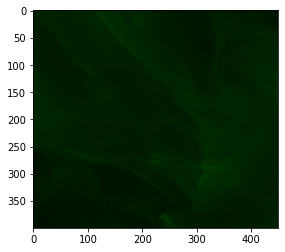

In [ ]:
img_bl = PILImage.fromarray(np.transpose(zoomed_img_array[:,6300:6700, 2200:2650], axes=[1,2,0]))
img_bl = np.asarray(img_bl)
img_bl_only = img_bl.copy()
h, w, c = img_bl.shape
for i in range(h):
  for j in range(w):
    img_bl_only[i,j,0] = 0
    img_bl_only[i,j,2] = 0
#img_bl.resize((target_w, target_h),resample = PILImage.BILINEAR)
plt.imshow(img_bl_only)

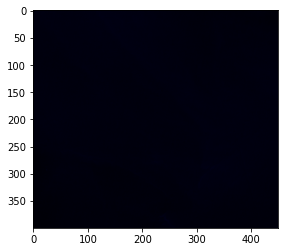

In [ ]:
img_bl = PILImage.fromarray(np.transpose(zoomed_img_array[:,6300:6700, 2200:2650], axes=[1,2,0]))
img_bl = np.asarray(img_bl)
img_bl_only = img_bl.copy()
h, w, c = img_bl.shape
for i in range(h):
  for j in range(w):
    img_bl_only[i,j,0] = 0
    img_bl_only[i,j,1] = 0
#img_bl.resize((target_w, target_h),resample = PILImage.BILINEAR)
plt.imshow(img_bl_only)

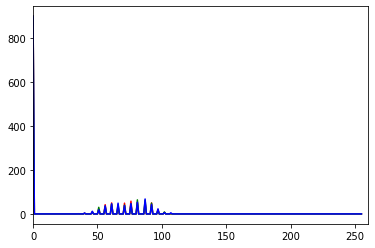

In [ ]:
color = ('r','g','b')
for i,col in enumerate(color):
    histr = cv.calcHist(img_bl_only,[i],None,[256],[0,50])
    plt.plot(histr,color = col)
    plt.xlim([0,260])
plt.show()

In [ ]:
img_bl_only.shape

(400, 450, 3)

In [ ]:
img_bl_only[150,100,0]

0

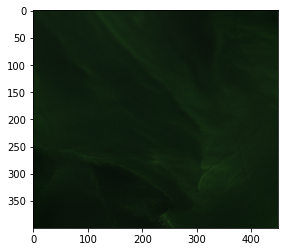

In [ ]:
img_bl = PILImage.fromarray(np.transpose(zoomed_img_array[:,6300:6700, 2200:2650], axes=[1,2,0]))
img_bl = np.asarray(img_bl)
img_bl_only = img_bl.copy()
h, w, c = img_bl.shape
for i in range(h):
  for j in range(w):
    for c in [0,1,2]:
      if img_bl_only[i,j,c] > 70:
        img_bl_only[i,j,c] = 0

#img_bl.resize((target_w, target_h),resample = PILImage.BILINEAR)
plt.imshow(img_bl_only)

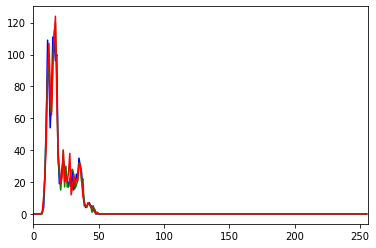

In [ ]:
import numpy as np
import cv2 as cv
from matplotlib import pyplot as plt

color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv.calcHist(img_bl_only,[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
plt.show()

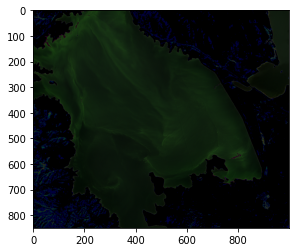

In [ ]:
#zoomed_img_array[:,6100:6950, 2000:3000]
img_bl = PILImage.fromarray(np.transpose(zoomed_img_array[:,6100:6950, 2000:3000], axes=[1,2,0]))
img_bl = np.asarray(img_bl)
img_bl_only = img_bl.copy()
h, w, c = img_bl.shape
for i in range(h):
  for j in range(w):
    for c in [0,1,2]:
      if img_bl_only[i,j,c] > 70:
        img_bl_only[i,j,c] = 256

#img_bl.resize((target_w, target_h),resample = PILImage.BILINEAR)
plt.imshow(img_bl_only)

In [ ]:
img_bl_only.shape

(850, 1000, 3)

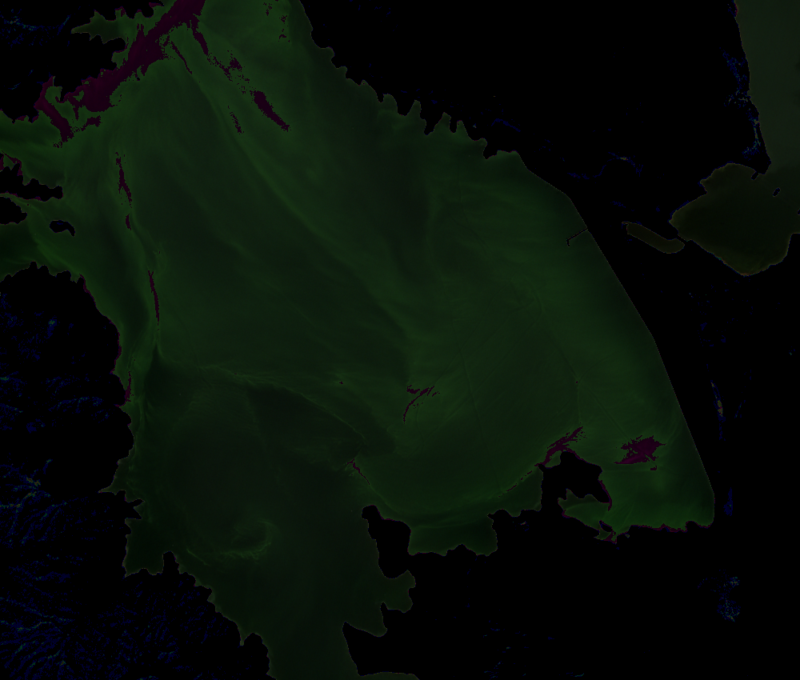

In [ ]:
img = PILImage.fromarray(img_bl_only)
w = img.size[0]
h = img.size[1]
aspect = w / h
target_w = 800
target_h = (int)(target_w / aspect)
img.resize((target_w, target_h),resample = PILImage.BILINEAR)

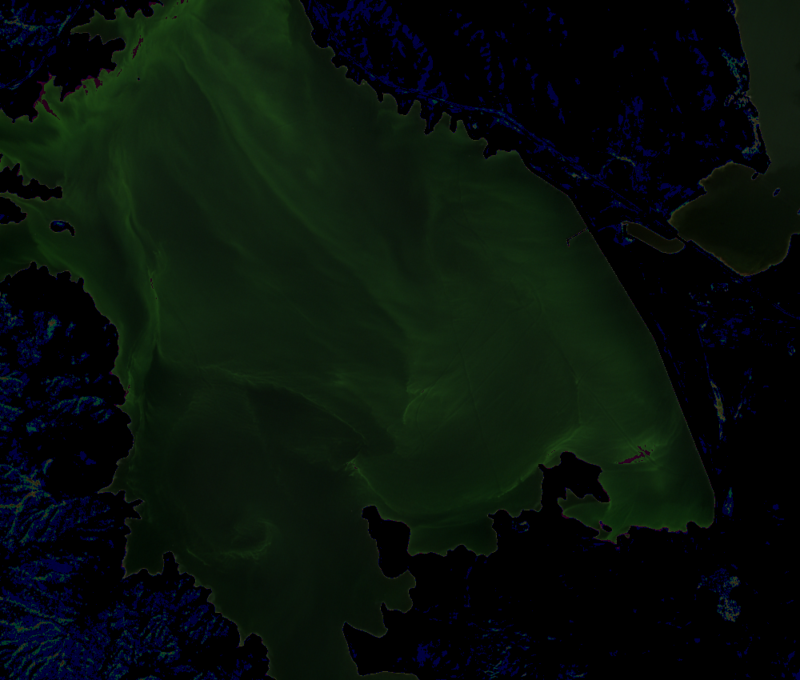

In [ ]:
img = PILImage.fromarray(img_bl_only)
w = img.size[0]
h = img.size[1]
aspect = w / h
target_w = 800
target_h = (int)(target_w / aspect)
img.resize((target_w, target_h),resample = PILImage.BILINEAR)

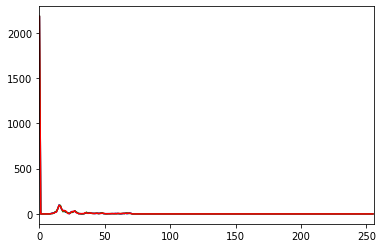

In [ ]:
color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv.calcHist(img_bl_only,[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
plt.show()

color targetted thresholding

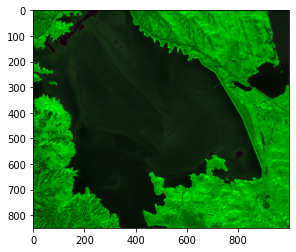

In [ ]:
img_bl = PILImage.fromarray(np.transpose(zoomed_img_array[:,6100:6950, 2000:3000], axes=[1,2,0]))
img_bl = np.asarray(img_bl)
img_bl_only = img_bl.copy()
h, w, c = img_bl.shape
for i in range(h):
  for j in range(w):
    #for c in [0,1,2]:
      if img_bl_only[i,j,0] > 30 and img_bl_only[i,j,2] > 30:
        img_bl_only[i,j,0] = 0
        img_bl_only[i,j,2] = 0
      elif img_bl_only[i,j,1] > 55 :
        img_bl_only[i,j,1] = 0

#img_bl.resize((target_w, target_h),resample = PILImage.BILINEAR)
plt.imshow(img_bl_only)

 River with algal bloom

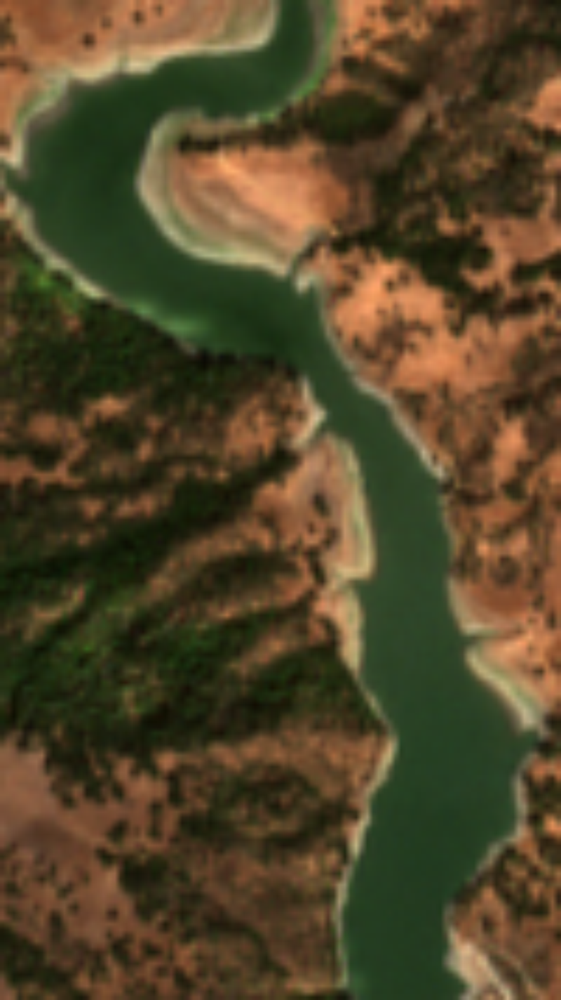

In [ ]:
img = PILImage.fromarray(np.transpose(zoomed_img_array[:,6450:-520, 800:900], axes=[1, 2, 0]))
w = img.size[0]
h = img.size[1]
aspect = w / h
target_w = 800
target_h = (int)(target_w / aspect)
img.resize((target_w, target_h),resample = PILImage.BILINEAR)

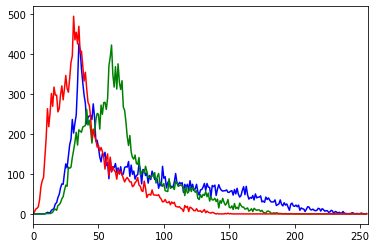

In [ ]:
import numpy as np
import cv2 as cv
from matplotlib import pyplot as plt

color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv.calcHist(zoomed_img_array[:,6450:-520, 800:900],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
plt.show()


In [ ]:
zoomed_img_array[:,6450:-520, 800:900].shape

(3, 178, 100)

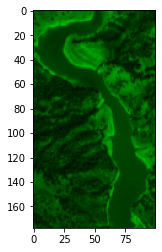

In [ ]:
img_bl = PILImage.fromarray(np.transpose(zoomed_img_array[:,6450:-520, 800:900], axes=[1,2,0]))
img_bl = np.asarray(img_bl)
img_bl_only = img_bl.copy()
for i in range(h):
  for j in range(w):
    img_bl_only[i,j,0] = 0
    img_bl_only[i,j,2] = 0
#img_bl.resize((target_w, target_h),resample = PILImage.BILINEAR)
plt.imshow(img_bl_only)

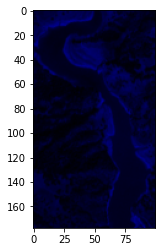

In [ ]:
img_bl = PILImage.fromarray(np.transpose(zoomed_img_array[:,6450:-520, 800:900], axes=[1,2,0]))
img_bl = np.asarray(img_bl)
img_bl_only = img_bl.copy()
for i in range(h):
  for j in range(w):
    img_bl_only[i,j,0] = 0
    img_bl_only[i,j,1] = 0
#img_bl.resize((target_w, target_h),resample = PILImage.BILINEAR)
plt.imshow(img_bl_only)

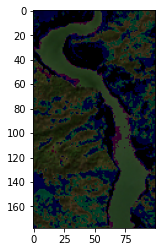

In [ ]:
img_bl = PILImage.fromarray(np.transpose(zoomed_img_array[:,6450:-520, 800:900], axes=[1,2,0]))
img_bl = np.asarray(img_bl)
img_bl_only = img_bl.copy()
h, w, c = img_bl.shape
for i in range(h):
  for j in range(w):
    for c in [0,1,2]:
      if img_bl_only[i,j,c] > 70:
        img_bl_only[i,j,c] = 256

#img_bl.resize((target_w, target_h),resample = PILImage.BILINEAR)
plt.imshow(img_bl_only)

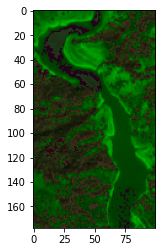

In [ ]:
img_bl = PILImage.fromarray(np.transpose(zoomed_img_array[:,6450:-520, 800:900], axes=[1,2,0]))
img_bl = np.asarray(img_bl)
img_bl_only = img_bl.copy()
h, w, c = img_bl.shape
for i in range(h):
  for j in range(w):
    #for c in [0,1,2]:
      if img_bl_only[i,j,0] > 30 and img_bl_only[i,j,2] > 30:
        img_bl_only[i,j,0] = 0
        img_bl_only[i,j,2] = 0
      elif img_bl_only[i,j,1] > 55 :
        img_bl_only[i,j,1] = 0

#img_bl.resize((target_w, target_h),resample = PILImage.BILINEAR)
plt.imshow(img_bl_only)

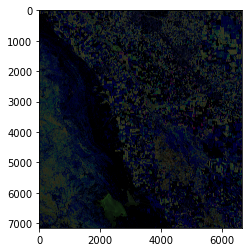

In [ ]:
img_bl = PILImage.fromarray(np.transpose(zoomed_img_array, axes=[1,2,0]))
img_bl = np.asarray(img_bl)
img_bl_only = img_bl.copy()
h, w, c = img_bl.shape
for i in range(h):
  for j in range(w):
    for c in [0,1,2]:
      if img_bl_only[i,j,c] > 70:
        img_bl_only[i,j,c] = 0

#img_bl.resize((target_w, target_h),resample = PILImage.BILINEAR)
plt.imshow(img_bl_only)

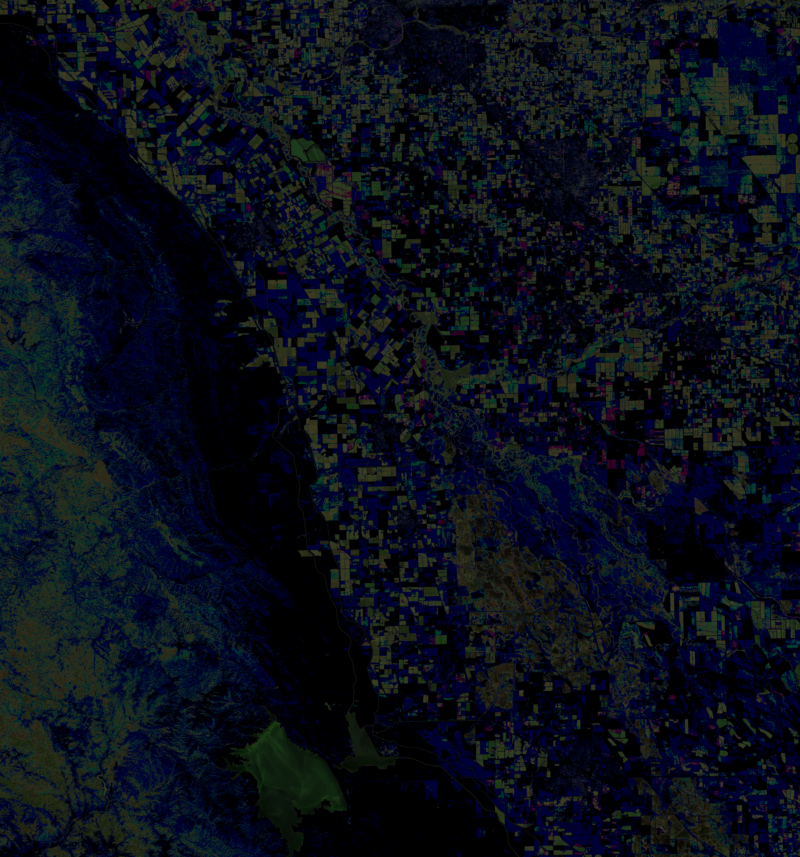

In [ ]:
img = PILImage.fromarray(img_bl_only)
w = img.size[0]
h = img.size[1]
aspect = w / h
target_w = 800
target_h = (int)(target_w / aspect)
img.resize((target_w, target_h),resample = PILImage.BILINEAR)

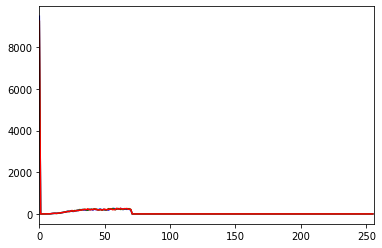

In [ ]:
color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv.calcHist(img_bl_only,[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
plt.show()

In [ ]:
img_bl_only.shape

(7148, 6668, 3)

In [ ]:
h , w , c = img_bl_only.shape

In [ ]:
im1 = img_bl_only[:,:h//2, :w//2]
im2 = img_bl_only[:,h//2:h, :w//2]
im3 = img_bl_only[:,:h//2, w//2:w]
im4 = img_bl_only[:,h//2:h, w//2:w]

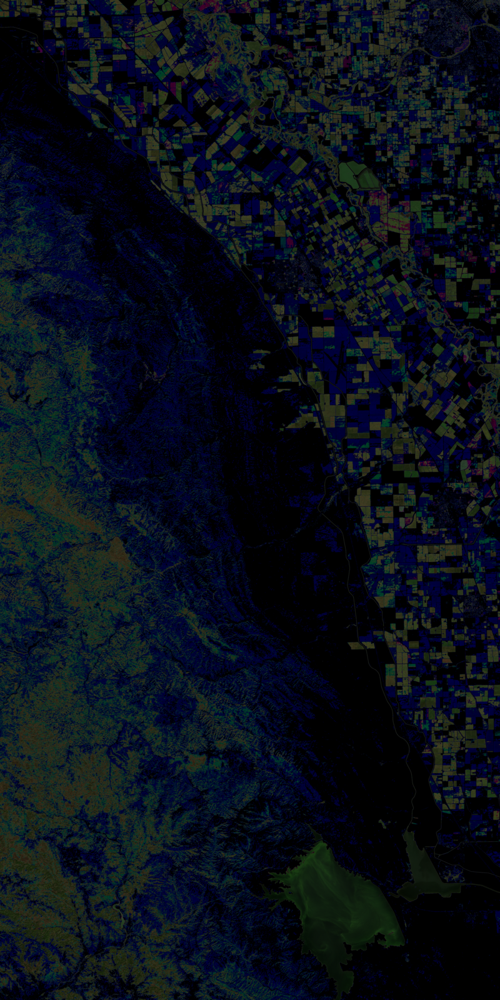

In [ ]:
img = PILImage.fromarray(im1)
w = img.size[0]
h = img.size[1]
aspect = w / h
target_w = 800
target_h = (int)(target_w / aspect)
img.resize((target_w, target_h),resample = PILImage.BILINEAR)

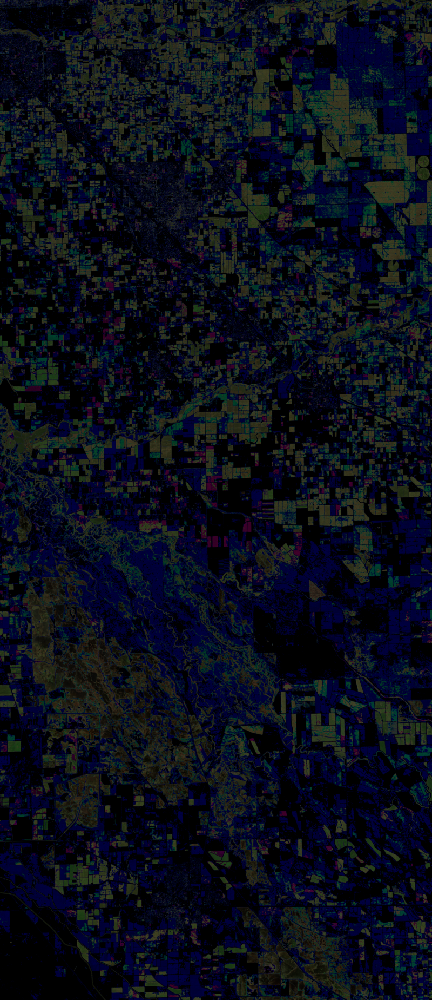

In [ ]:
img = PILImage.fromarray(im2)
w = img.size[0]
h = img.size[1]
aspect = w / h
target_w = 800
target_h = (int)(target_w / aspect)
img.resize((target_w, target_h),resample = PILImage.BILINEAR)

In [ ]:
img = PILImage.fromarray(im3)
w = img.size[0]
h = img.size[1]
aspect = w / h
target_w = 800
target_h = (int)(target_w / aspect)
img.resize((target_w, target_h),resample = PILImage.BILINEAR)

TypeError: ignored

In [ ]:
# take a random subset of the training data for the benchmark
train_subset = metadata[metadata["split"] == "train"].sample(n=17060, random_state=2)

# combine train subset with all test data
metadata_subset = pd.concat([train_subset, metadata[metadata["split"] == "test"]])
metadata_subset.split.value_counts(dropna=False)

train    17060
test      6510
Name: split, dtype: int64

## another exemple img

In [ ]:
# see the whole image
img_x = Image(url=item.assets["rendered_preview"].href, width=500)

Image(url=item.assets["rendered_preview"].href, width=500) # return IPython.core.display.Image not PIL img

In [ ]:
type(img_x)

IPython.core.display.Image

### RGB_Histogram

In [ ]:
def RGB_Histogram(img):
  color = ('b','g','r')
  img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
  for i,col in enumerate(color):
      histr = cv2.calcHist(img,[i],None,[256],[0,256])
      plt.plot(histr,color = col)
      plt.xlim([0,260])
  plt.show()

In [ ]:
#opencv_img = cv2.cvtColor(np.array(img_x), cv2.COLOR_RGB2BGR)

In [ ]:
type(img_x)

numpy.ndarray

### Get bounding box

In [ ]:
minx, miny, maxx, maxy = get_bounding_box(
    example_row.latitude, example_row.longitude, meter_buffer=35000
)
bbox = (minx, miny, maxx, maxy)
bbox

(-121.155910380709, 36.82122003978745, -120.368089619291, 37.45196314080626)

In [ ]:
zoomed_img_x_array = crop_sentinel_image(item, bbox)
#zoomed_img_x_array[0]

### plot array img

In [ ]:
# we have to transpose some of the dimensions to plot
# matplotlib expects channels in a certain order
def plot_array_img(img):
  plt.figure(figsize=(10,10))
  plt.imshow(np.transpose(img, axes=[1, 2, 0]))

In [ ]:
zoomed_img_x_array.shape

(3, 5807, 4669)

In [ ]:
zoomed_img_x_array[0][:,0].shape

(5807,)

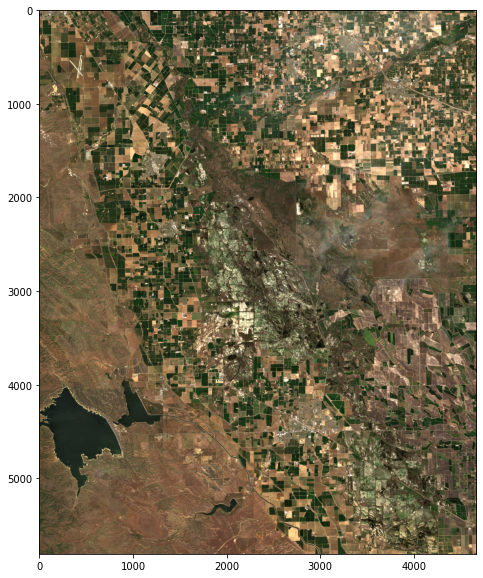

In [ ]:
plot_array_img(zoomed_img_x_array)

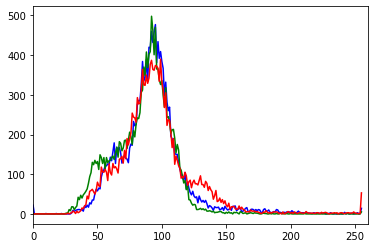

In [ ]:
RGB_Histogram(zoomed_img_x_array)

### split_img_to_four

In [ ]:
def split_img_to_four(img):
  c , h , w = img.shape
  im1 = img[:,:h//2, :w//2]
  im2 = img[:,h//2:h, :w//2]
  im3 = img[:,:h//2, w//2:w]
  im4 = img[:,h//2:h, w//2:w]
  return im1 , im2 , im3 , im4

In [ ]:
img1,img2,img3,img4 = split_img_to_four(zoomed_img_x_array)

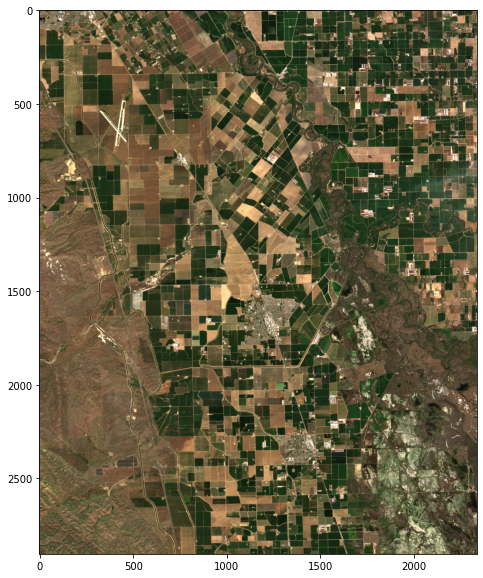

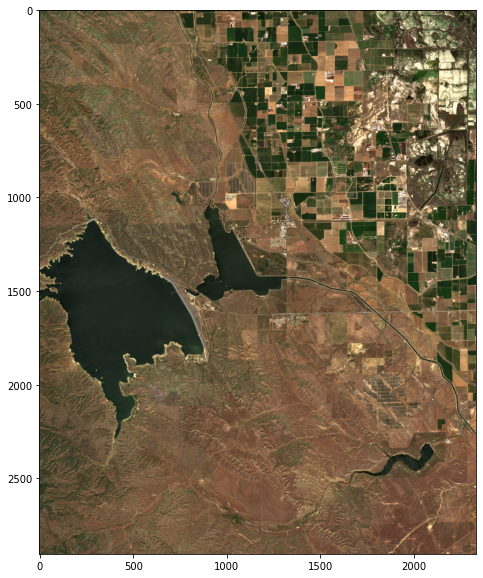

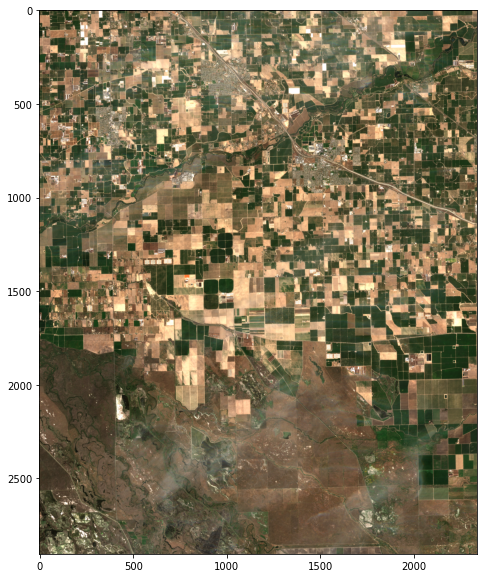

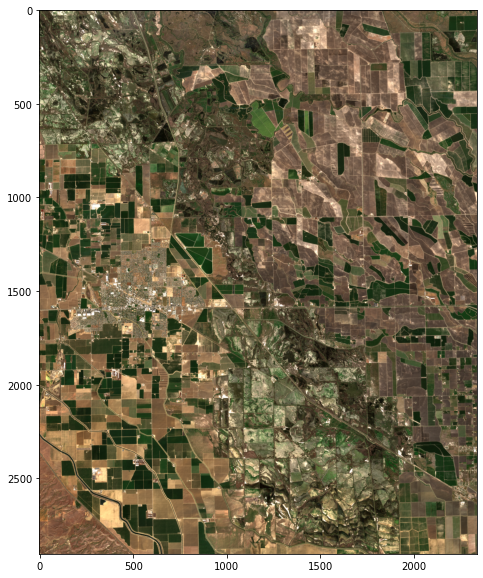

In [ ]:
for im in [img1,img2,img3,img4]:
  plot_array_img(im)

  ### remove color channel

In [ ]:
def keep_color(img_bl, color):
  color_dict = {'r':0,'g':1,'b':2}
  #img_bl = PILImage.fromarray(np.transpose(zoomed_img_array[:,5900:, 1750:3500], axes=[1,2,0]))
  #img_bl = np.asarray(img_bl)
  c , h , w = img_bl.shape
  img_bl_only = img_bl.copy()
  color_dict.pop(color,None)
  for i in range(h):
    for j in range(w):
      for v in color_dict.values():
        img_bl_only[v,i,j] = 0
        img_bl_only[v,i,j] = 0
  #img_bl.resize((target_w, target_h),resample = PILImage.BILINEAR)
  plt.imshow(np.transpose(img_bl_only, axes=[1, 2, 0]))

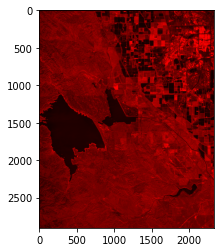

In [ ]:
keep_color(img2, 'r')

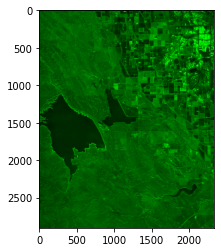

In [ ]:
keep_color(img2, 'g')

In [ ]:
def big_display(img):
  img = PILImage.fromarray(np.transpose(img, axes=[1, 2, 0]))
  w = img.size[0]
  h = img.size[1]
  aspect = w / h
  target_w = 800
  target_h = (int)(target_w / aspect)
  display(img.resize((target_w, target_h),resample = PILImage.BILINEAR))


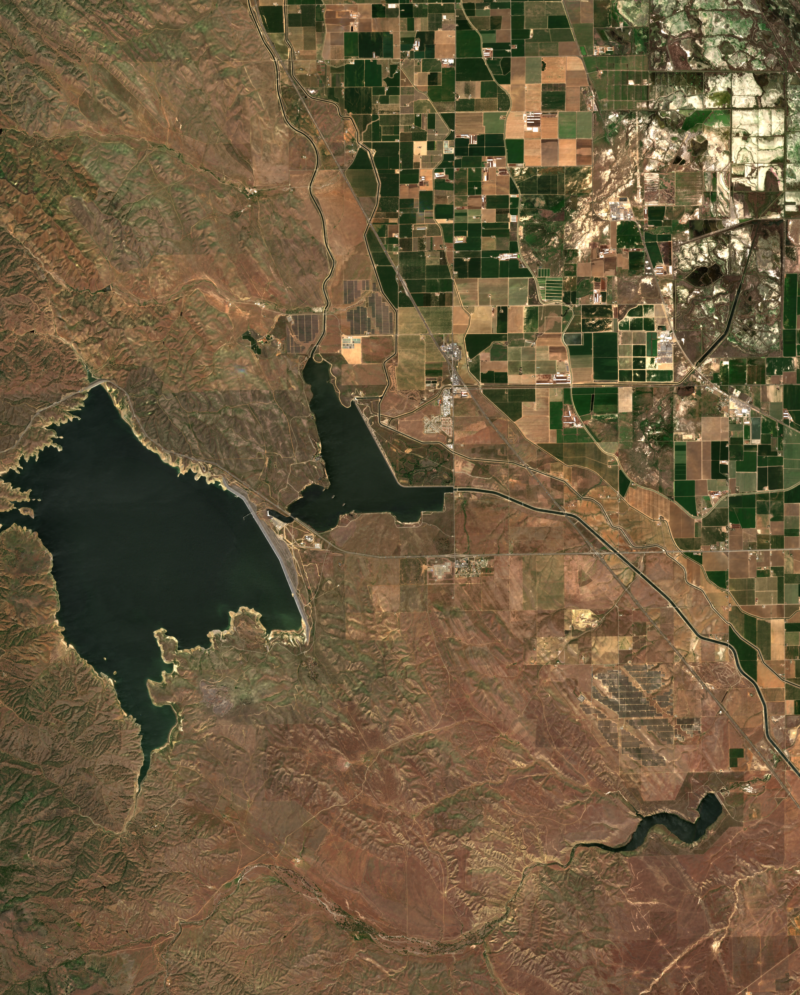

In [ ]:
big_display(img2)

splitting exemples

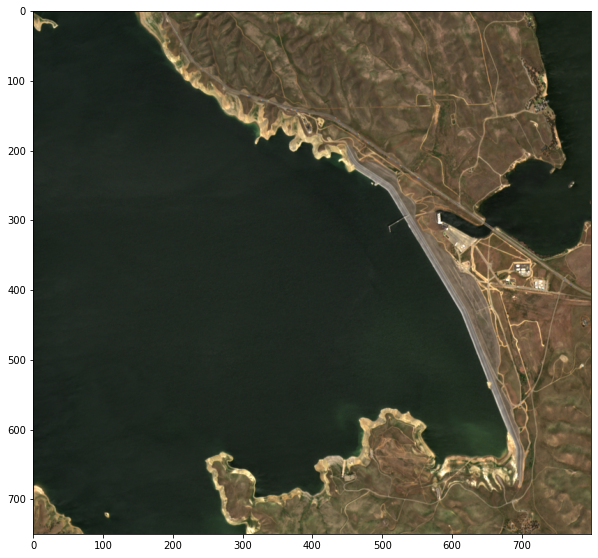

In [ ]:
plot_array_img(img2[:,1200:2000,:1000])

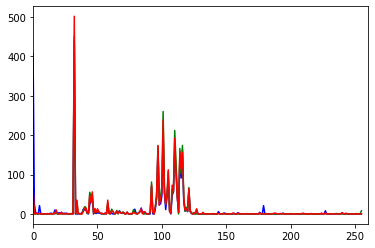

In [ ]:
RGB_Histogram(img2[:,1000:2000,:1000])

In [ ]:
img2_1, img2_2 , img2_3 , img2_4 = split_img_to_four(img2)

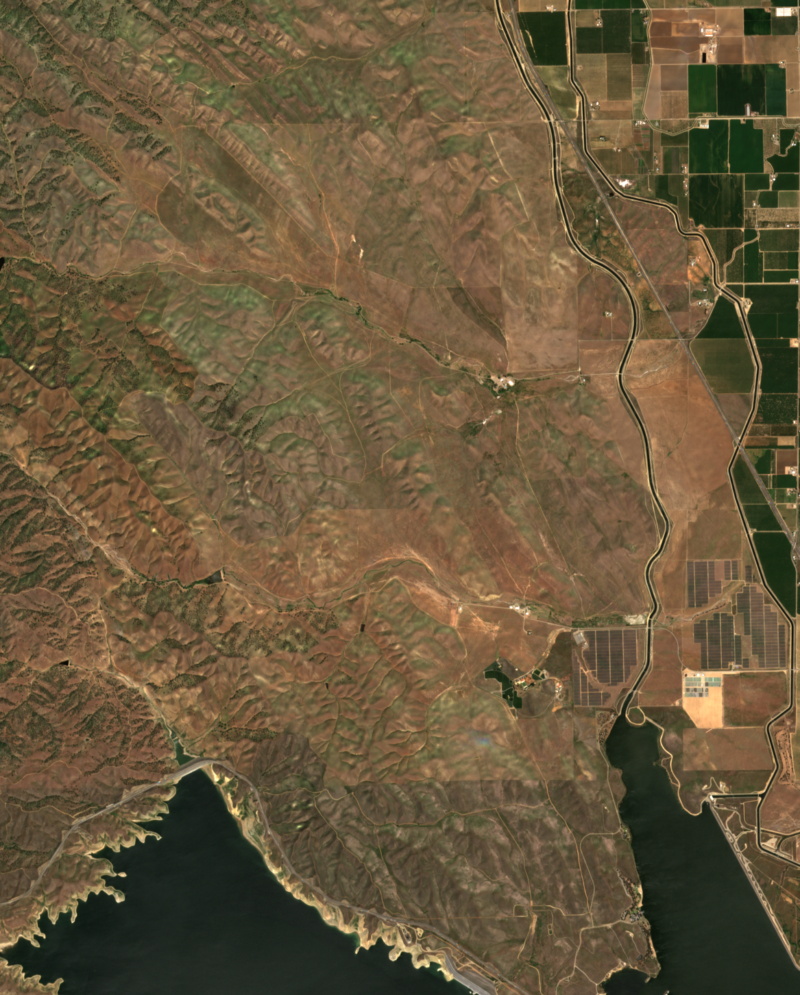

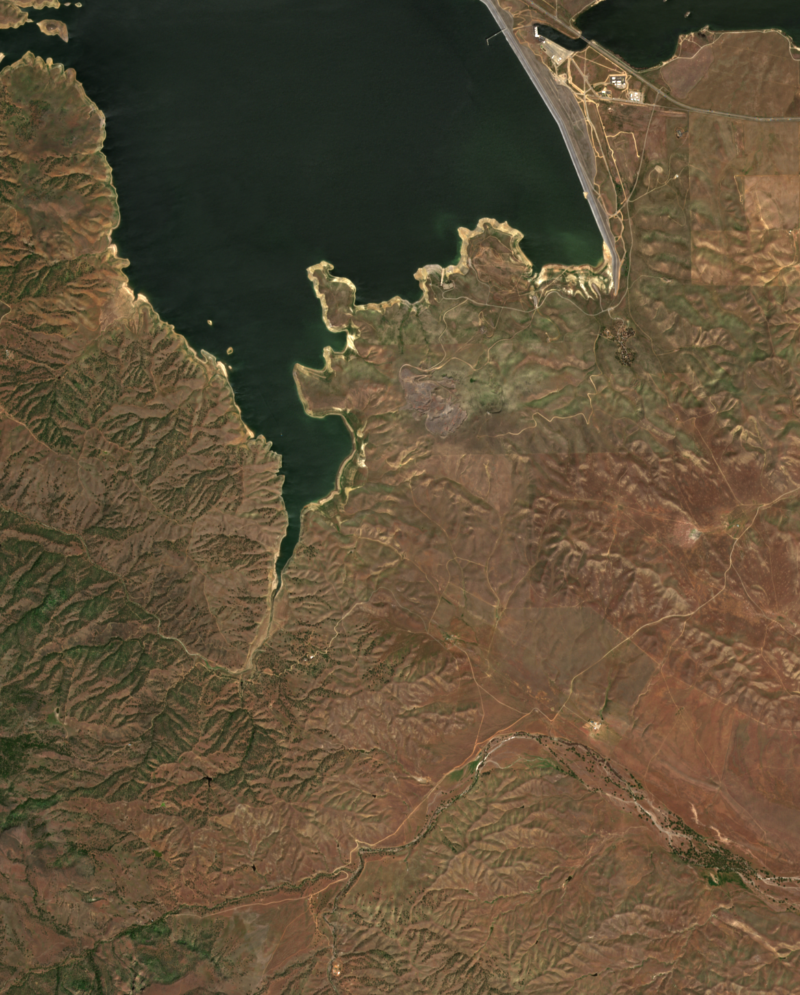

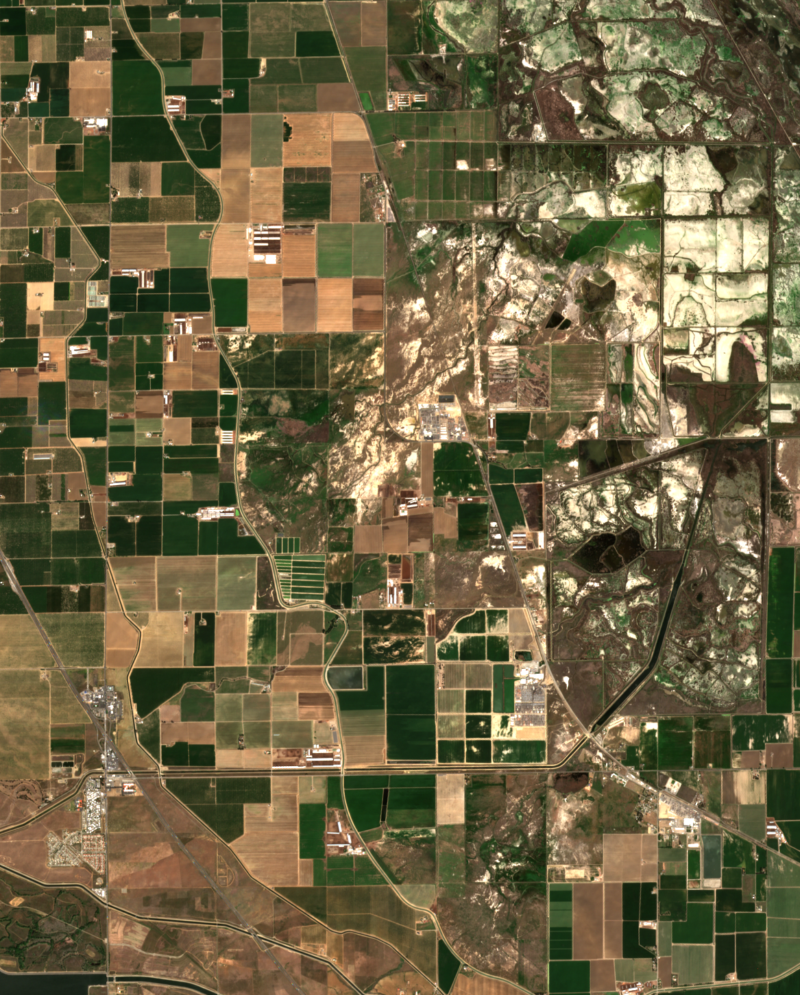

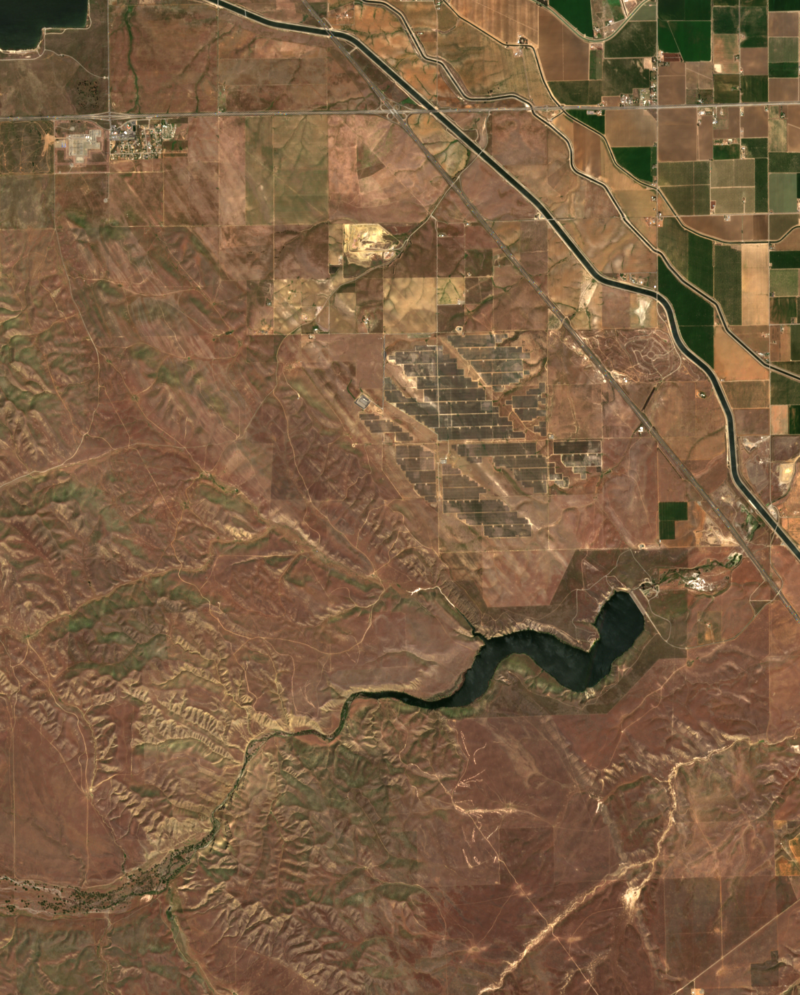

In [ ]:
for im in [img2_1,img2_2,img2_3,img2_4]:
  big_display(im)

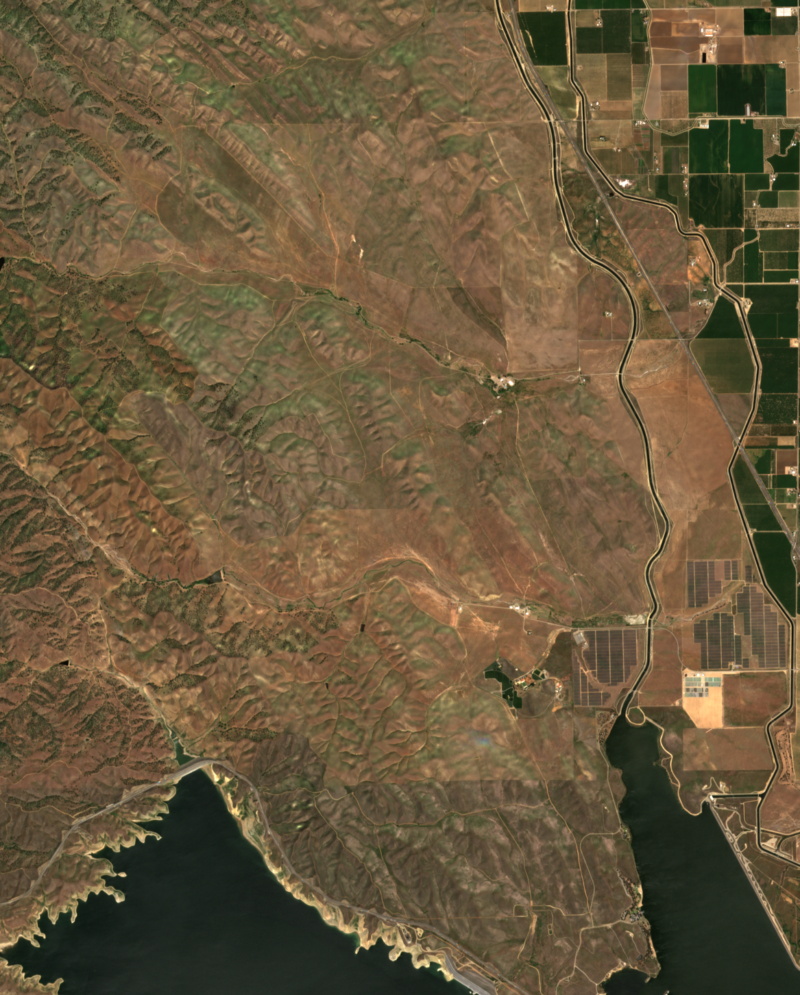

In [ ]:
big_display(img2_1)

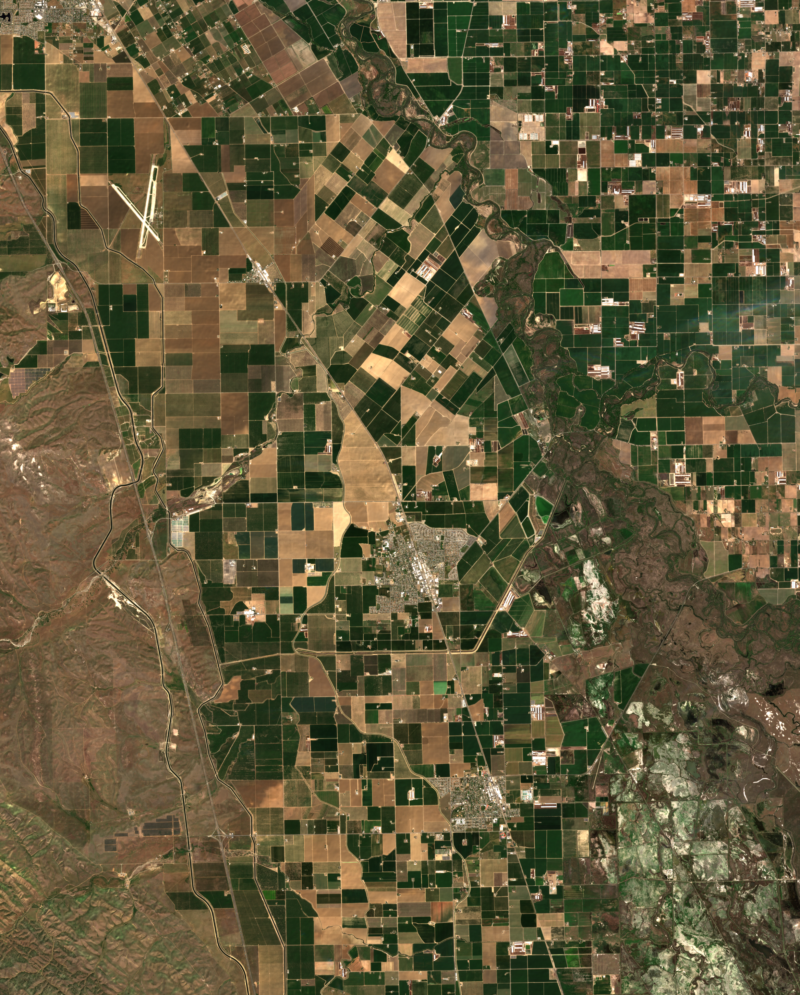

In [ ]:
big_display(img1)

In [ ]:
def seuillage(img):
  _ , h , w = img_bl.shape
  img_bl_only = img_bl.copy()
  for i in range(h):
    for j in range(w):
      for c in [0,1,2]:
        if img_bl_only[c,i,j] > 70:
          img_bl_only[c,i,j] = 0
  plt.imshow(np.transpose(img_bl_only, axes=[1, 2, 0]))

In [ ]:
img2_2.shape

(3, 1452, 1167)

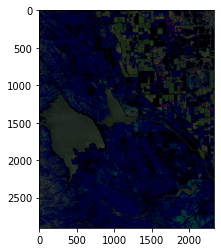

In [ ]:
seuillage(img2_2)

### Visualizing Landsat imagery

In [ ]:
landsat_item = (
    item_details[item_details.platform.str.contains("landsat")]
    .sample(n=1, random_state=3)
    .iloc[0]
)
landsat_item

datetime                                                        2017-02-24
platform                                                         landsat-8
min_long                                                       -120.802064
max_long                                                       -118.132711
min_lat                                                          34.932255
max_lat                                                          37.133485
bbox                     [-120.80206419, 34.93225492, -118.1327113, 37....
item_obj                         <Item id=LC08_L2SP_042035_20170224_02_T1>
contains_sample_point                                                 True
Name: 17, dtype: object

In [ ]:
def crop_landsat_image(item, bounding_box):
    """
    Given a STAC item from Landsat and a bounding box tuple in the format
    (minx, miny, maxx, maxy), return a cropped portion of the item's visual
    imagery in the bounding box.

    Returns the image as a numpy array with dimensions (color band, height, width)
    """
    (minx, miny, maxx, maxy) = bounding_box

    image = odc.stac.stac_load(
        [pc.sign(item)], bands=["red", "green", "blue"], bbox=[minx, miny, maxx, maxy]
    ).isel(time=0)
    image_array = image[["red", "green", "blue"]].to_array().to_numpy()

    fig, ax = plt.subplots(figsize=(10, 10))

    image[["red", "green", "blue"]].to_array().plot.imshow(robust=True, ax=ax)
    ax.set_title("Natural Color, Redmond, WA");

    # normalize to 0 - 255 values
   # image_array = cv2.normalize(image_array, None, 0, 255, cv2.NORM_MINMAX)


    #return image_array

In [ ]:
item_lds = landsat_item.item_obj

In [ ]:
# see the whole image
img = Image(url=item_lds.assets["rendered_preview"].href, width=500)

Image(url=item_lds.assets["rendered_preview"].href, width=500)

In [ ]:
landsat_item.item_obj

ID: LC08_L2SP_042035_20170224_02_T1
"Bounding Box: [-120.80206419, 34.93225492, -118.1327113, 37.13348508]"
Datetime: 2017-02-24 18:34:00.205791+00:00
gsd: 30
created: 2022-05-06T17:46:39.615829Z
sci:doi: 10.5066/P9OGBGM6
datetime: 2017-02-24T18:34:00.205791Z
platform: landsat-8
proj:epsg: 32611
"proj:shape: [7951, 7821]"
description: Landsat Collection 2 Level-2


## comment
landsat images don't have assets called "visual"

In [ ]:
# see the whole image
img = Image(url=item.assets["visual"].href, width=500)

Image(url=item.assets["visual"].href, width=500)

KeyError: ignored

TypeError: ignored

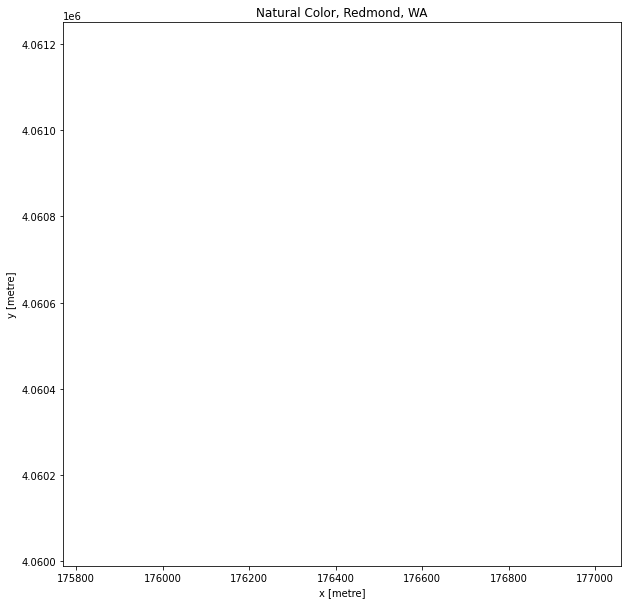

In [ ]:

# we'll use the same cropped area as above
landsat_image_array = crop_landsat_image(item_lds, bbox)
landsat_image_array[0]

In [ ]:
item

In [ ]:
plt.imshow(np.transpose(landsat_image_array, axes=[1, 2, 0]))

ValueError: ignored

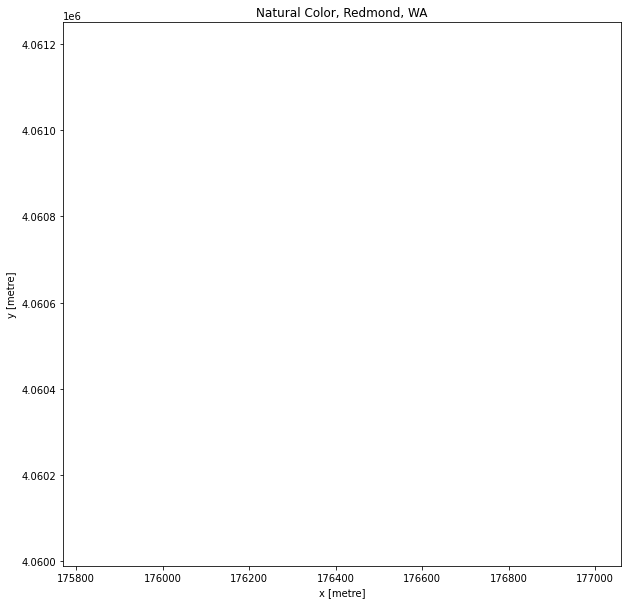

In [ ]:
crop_landsat_image(item_lds, bbox)

In [ ]:
asset_href = item.assets["visual"].href
with rasterio.open(asset_href) as ds:
    #aoi_bounds = features.bounds(area_of_interest)
    aoi_bounds = bbox
    warped_aoi_bounds = warp.transform_bounds("epsg:4326", ds.crs, *aoi_bounds)
    aoi_window = windows.from_bounds(transform=ds.transform, *warped_aoi_bounds)
    band_data = ds.read(window=aoi_window)

In [ ]:
# load image but don't convert to numpy or rescale
image = odc.stac.stac_load(
    [pc.sign(item)], bands=["red", "green", "blue"], bbox=bbox
).isel(time=0)
image_array = image[["red", "green", "blue"]].to_array()

# values are not scaled 0 - 255 when first returned
image_array[0]

<xarray.DataArray (y: 124, x: 124)>
array([[1914., 1112.,  327., ..., 1318., 1312., 1320.],
       [2010., 1780.,  581., ..., 1334., 1338., 1340.],
       [1678., 2014., 1294., ..., 1340., 1344., 1338.],
       ...,
       [ 255.,  299.,  296., ..., 2030., 2044., 2032.],
       [ 262.,  279.,  273., ..., 1930., 1962., 1938.],
       [ 256.,  266.,  268., ..., 2154., 2078., 2100.]], dtype=float32)
Coordinates:
  * y            (y) float64 4.058e+06 4.058e+06 ... 4.057e+06 4.057e+06
  * x            (x) float64 7.123e+05 7.123e+05 ... 7.135e+05 7.135e+05
    spatial_ref  int32 32610
    time         datetime64[ns] 2017-03-01T19:03:41.026000
    variable     <U3 'red'

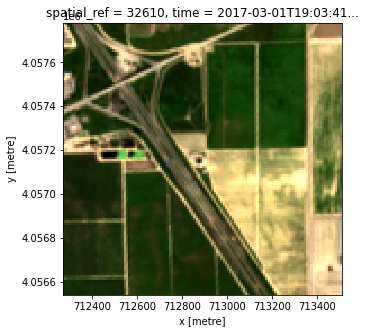

In [ ]:
# image appears differently without rescaling
fig, ax = plt.subplots(figsize=(5, 5))
image_array.plot.imshow(robust=True, ax=ax)

# Conclusion

bbox = les coodonnées géographique du Lac formés par l'unique longitude et latitude

# Convert imagery to features

In [ ]:
# define a small area to crop around
# crop to 400 meters squared around the sampling point
minx, miny, maxx, maxy = get_bounding_box(
    example_row.latitude, example_row.longitude, meter_buffer=400
)
minx, miny, maxx, maxy

(-120.6364734827315, 36.648295457800124, -120.6275265172685, 36.65550454001357)

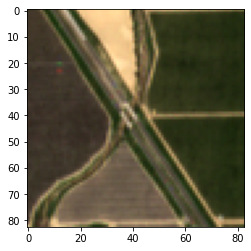

In [ ]:
bbox = (minx, miny, maxx, maxy)
item2 = best_item.item_obj
feature_image_array = crop_sentinel_image(item2, bbox)

plt.imshow(np.transpose(feature_image_array, axes=[1, 2, 0]))

In [ ]:
asset_href = item2.assets["visual"].href
with rasterio.open(asset_href) as ds:
    #aoi_bounds = features.bounds(area_of_interest)
    aoi_bounds = bbox
    warped_aoi_bounds = warp.transform_bounds("epsg:4326", ds.crs, *aoi_bounds)
    aoi_window = windows.from_bounds(transform=ds.transform, *warped_aoi_bounds)
    band_data = ds.read(window=aoi_window)

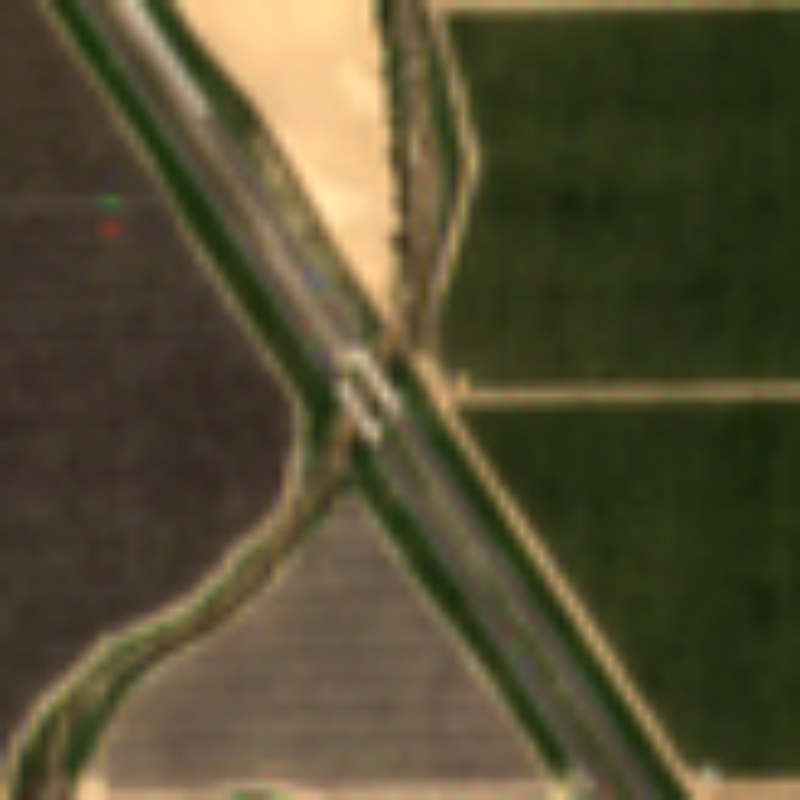

In [ ]:
img = PILImage.fromarray(np.transpose(band_data, axes=[1, 2, 0]))
w = img.size[0]
h = img.size[1]
aspect = w / h
target_w = 800
target_h = (int)(target_w / aspect)
img.resize((target_w, target_h),resample = PILImage.BILINEAR)

In [ ]:
type(feature_image_array), feature_image_array.shape

(numpy.ndarray, (3, 82, 82))

## extracting features

In [ ]:
# take the average over the second and third dimensions
image_color_averages = feature_image_array.mean(axis=(1, 2)).tolist()

# also take the median
image_color_medians = np.median(feature_image_array, axis=(1, 2)).tolist()

# concatenate the two lists
image_features = image_color_averages + image_color_medians
image_features

[95.75089232599643, 97.07659131469363, 69.78643664485425, 63.0, 87.0, 52.0]

In [ ]:
# Refactor our process from above into functions
def select_best_item(items, date, latitude, longitude):
    """
    Select the best satellite item given a sample's date, latitude, and longitude.
    If any Sentinel-2 imagery is available, returns the closest sentinel-2 image by
    time. Otherwise, returns the closest Landsat imagery.

    Returns a tuple of (STAC item, item platform name, item date)
    """
    # get item details
    item_details = pd.DataFrame(
        [
            {
                "datetime": item.datetime.strftime("%Y-%m-%d"),
                "platform": item.properties["platform"],
                "min_long": item.bbox[0],
                "max_long": item.bbox[2],
                "min_lat": item.bbox[1],
                "max_lat": item.bbox[3],
                "item_obj": item,
            }
            for item in items
        ]
    )

    # filter to items that contain the point location, or return None if none contain the point
    item_details["contains_sample_point"] = (
        (item_details.min_lat < latitude)
        & (item_details.max_lat > latitude)
        & (item_details.min_long < longitude)
        & (item_details.max_long > longitude)
    )
    item_details = item_details[item_details["contains_sample_point"] == True]
    if len(item_details) == 0:
        return (np.nan, np.nan, np.nan)

    # add time difference between each item and the sample
    item_details["time_diff"] = pd.to_datetime(date) - pd.to_datetime(
        item_details["datetime"]
    )

    # if we have sentinel-2, filter to sentinel-2 images only
    item_details["sentinel"] = item_details.platform.str.lower().str.contains(
        "sentinel"
    )
    if item_details["sentinel"].any():
        item_details = item_details[item_details["sentinel"] == True]

    # return the closest imagery by time
    best_item = item_details.sort_values(by="time_diff", ascending=True).iloc[0]

    return (best_item["item_obj"], best_item["platform"], best_item["datetime"])


def image_to_features(image_array):
    """
    Convert an image array of the form (color band, height, width) to a
    1-dimensional list of features. Returns a list where the first three
    values are the averages of each color band, and the second three
    values are the medians of each color band.
    """
    averages = image_array.mean(axis=(1, 2)).tolist()
    medians = np.median(image_array, axis=(1, 2)).tolist()

    return averages + medians